# Basic Aug with no Aug on testing 100 epochs

## Custom Parameters
Here you can change some of the main parameters of the model

In [1]:
width = 256
height = 256

epochs = 100

batch_size = 16
learning_rate = 0.001

show_images = True

### Imports

In [2]:
from PIL import Image
import torch
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torchvision.transforms import ToTensor, ToPILImage
from torchvision.utils import save_image
from torchvision import ops
import cv2
import sys

sys.path.append(r'D:\Estudos\IC\CNN\CNN\Model')
from TrainingDataArrangement import arrange_data
from torchvision.transforms import v2
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
import matplotlib.pyplot as plt
import os
import numpy as np
import CustomDataset
from UNetModel import UNet
import albumentations as A
from albumentations.pytorch import ToTensorV2
import random

#defining device
device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.10 (you have 1.4.8). Upgrade using: pip install --upgrade albumentations


Using cuda device


### Setting the seed

In [3]:
def set_seed(seed):  
    random.seed(seed) #setting for albumentations
    np.random.seed(seed)
    
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

set_seed(727)

### Getting the dataset

C:\Users\Gabriel\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\pydantic\main.py:347: UserWarning: Pydantic serializer warnings:
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  return self.__pydantic_serializer__.to_python(


Showing images: True
Getting the images
Converting images to tensors


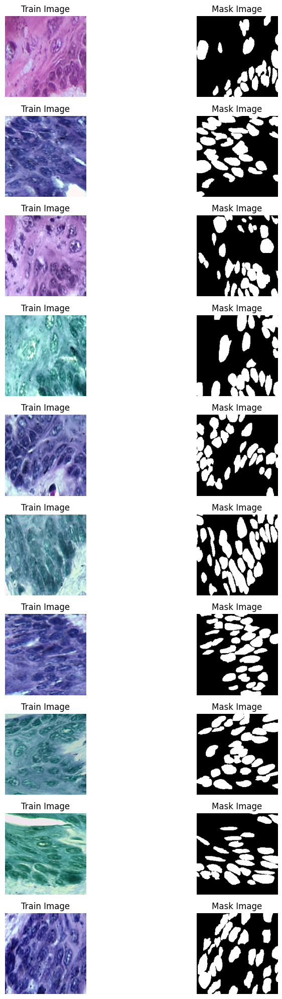

In [4]:
#getting path references


training_path = r"D:\Estudos\IC\DataSets\OralEpitheliumDB\Images\Original ROI images\Training"
mask_path = r"D:\Estudos\IC\DataSets\OralEpitheliumDB\Images\Gold_Standard_Semantic_Segmentation\Training"
test_path = r"D:\Estudos\IC\DataSets\OralEpitheliumDB\Images\Original ROI images\Test"
test_mask_path = r"D:\Estudos\IC\DataSets\OralEpitheliumDB\Images\Gold_Standard_Semantic_Segmentation\Test"

#data augmentation
augmentation_transform = A.Compose([
    #A.ToPIL(),
    A.Resize(width = width, height = height, p=1.0),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.25),
    A.RandomRotate90(p=0.5),
    A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    A.Transpose(p=0.25),
    A.RandomResizedCrop(224, 224, scale=(0.8, 1.0)),
    # A.GridDistortion(num_steps=5, distort_limit=(-0.3, 0.3), interpolation=1, border_mode=4, p=0.3),
    # A.ElasticTransform(alpha=1, sigma=50, alpha_affine=50, interpolation=1, border_mode=4, p=0.3),
    # A.OpticalDistortion(distort_limit=(-0.05, 0.05), shift_limit=(-0.05, 0.05), interpolation=1, border_mode=4, p=0.3),
    # A.Perspective(scale=(0.05, 0.1), keep_size=True, pad_mode=0, pad_val=0, mask_pad_val=0, fit_output=False, interpolation=1, p=0.3),
    # A.PiecewiseAffine (scale=(0.03, 0.05), nb_rows=4, nb_cols=4, interpolation=1, mask_interpolation=0, cval=0, cval_mask=0, mode='constant', absolute_scale=False, keypoints_threshold=0.01, p=0.1),
    # A.ShiftScaleRotate (shift_limit=(-0.0625, 0.0625), scale_limit=(-0.1, 0.1), rotate_limit=(-45, 45), interpolation=1, border_mode=4, value=0, mask_value=0, rotate_method='largest_box', p=0.15),
    ToTensorV2()  # loading image to tensor and normalization
])
test_transform = A.Compose([
    #A.ToPIL(),
    A.Resize(width = width, height = height, p=1.0),
    # A.HorizontalFlip(p=0.5),
    # A.VerticalFlip(p=0.25),
    # A.RandomRotate90(p=0.5),
    # A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    # A.Transpose(p=0.5),
    #A.RandomResizedCrop(224, 224, scale=(0.8, 1.0)),
    ToTensorV2()  # loading image to tensor and normalization
])

print("Showing images:", show_images)

print("Getting the images")
training_dataset = CustomDataset.CustomImageDataset(training_path , mask_path , transform=augmentation_transform)
test_dataset = CustomDataset.CustomImageDataset(test_path, test_mask_path, transform=test_transform)

print("Converting images to tensors")
train_dataloader = DataLoader(training_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = DataLoader(test_dataset , batch_size=batch_size, shuffle=False)
if(show_images):
    num_images_to_display = 10
    fig, axs = plt.subplots(num_images_to_display, 2, figsize=(10, 20))
    for i in range(num_images_to_display):
        train_image, mask_image = training_dataset[i]
        train_image = train_image.permute(1, 2, 0).numpy()

        axs[i, 0].imshow(train_image)
        axs[i, 0].set_title('Train Image')
        axs[i, 0].axis('off')

        mask_image = mask_image.squeeze(0).numpy()
        axs[i, 1].imshow(mask_image, cmap='gray')
        axs[i, 1].set_title('Mask Image')
        axs[i, 1].axis('off')

    plt.tight_layout()
    plt.show()


### Training

Epoch 1 Loss: 0.5636, Accuracy: 72.74%


Validation Loss: 0.4744, Validation Accuracy: 80.32%


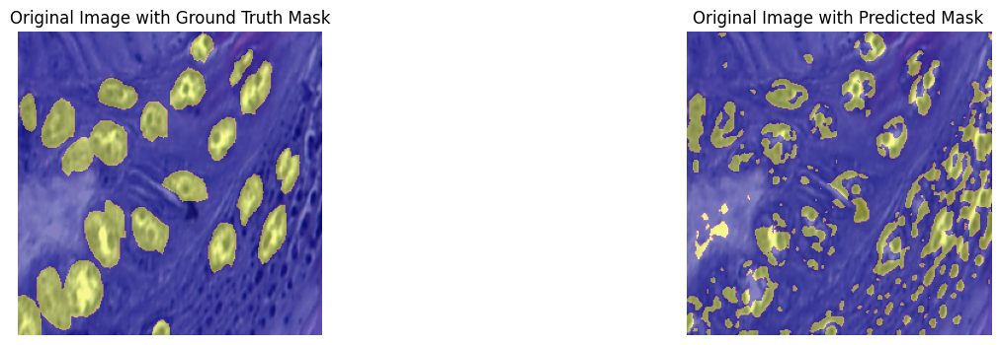

Epoch 2 Loss: 0.4923, Accuracy: 77.47%


Validation Loss: 0.4344, Validation Accuracy: 80.83%


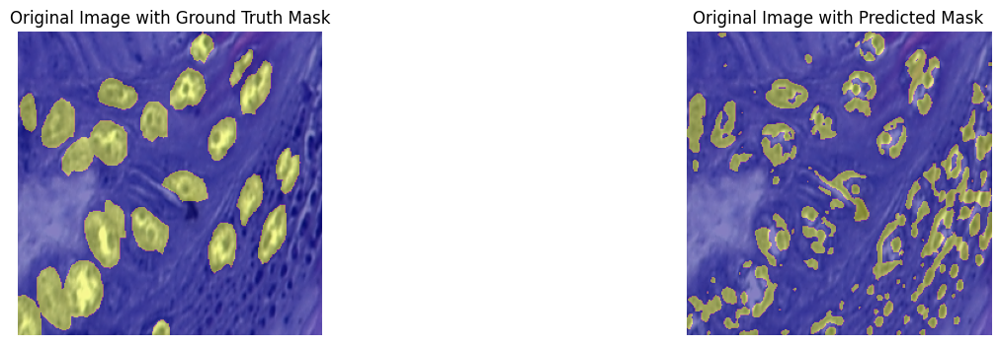

Epoch 3 Loss: 0.4653, Accuracy: 78.72%


Validation Loss: 0.4358, Validation Accuracy: 80.61%


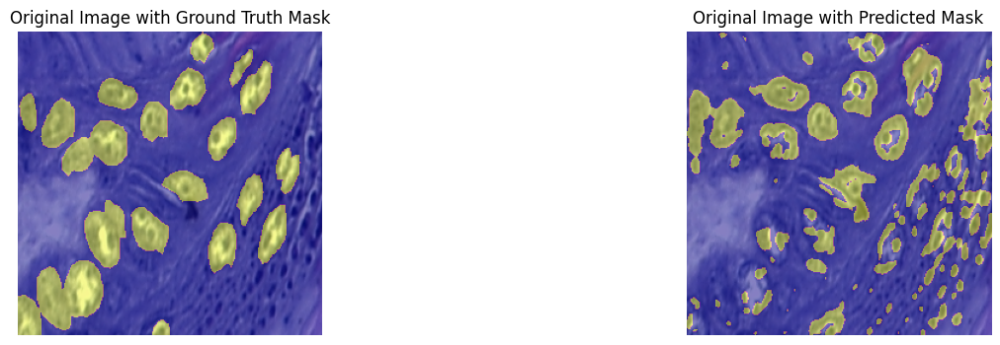

Epoch 4 Loss: 0.4531, Accuracy: 78.92%


Validation Loss: 0.4323, Validation Accuracy: 79.84%


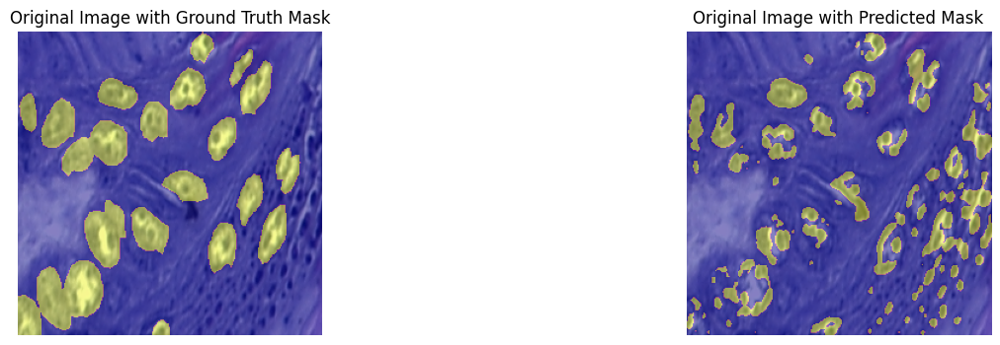

Epoch 5 Loss: 0.4427, Accuracy: 79.52%


Validation Loss: 0.4075, Validation Accuracy: 81.32%


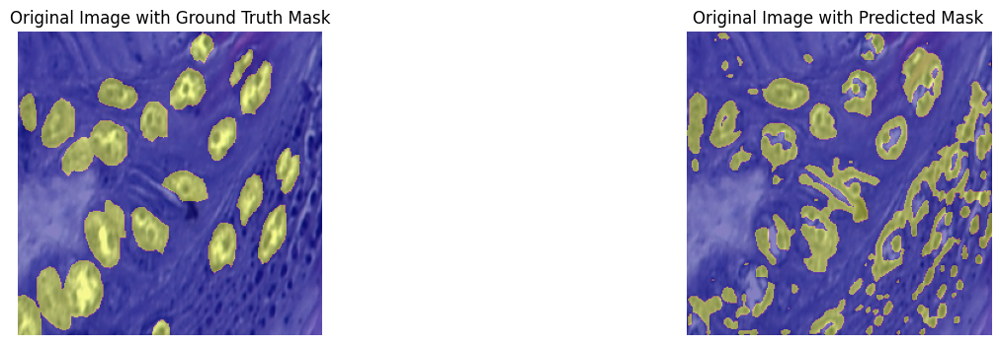

Epoch 6 Loss: 0.4322, Accuracy: 79.90%


Validation Loss: 0.4043, Validation Accuracy: 81.40%


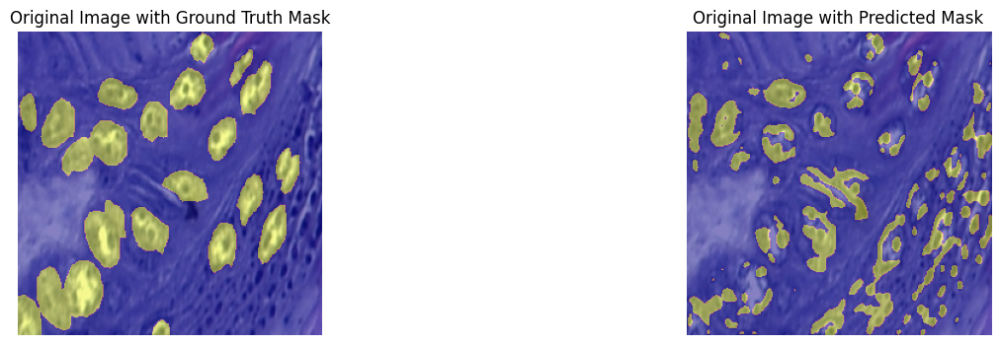

Epoch 7 Loss: 0.4295, Accuracy: 79.95%


Validation Loss: 0.4005, Validation Accuracy: 81.67%


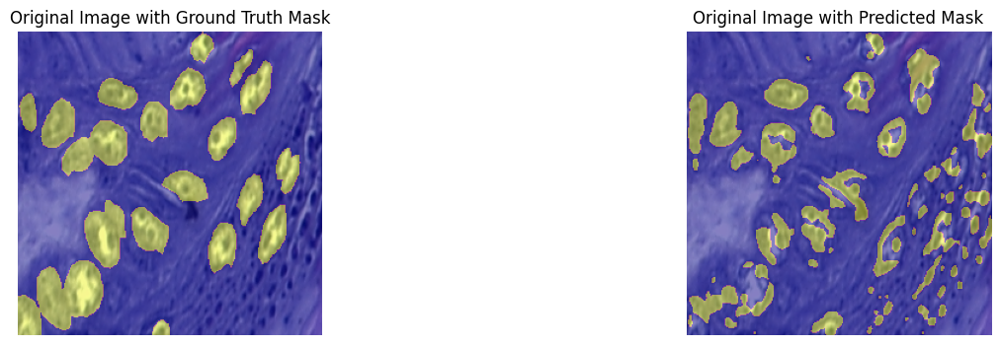

Epoch 8 Loss: 0.4404, Accuracy: 79.74%


Validation Loss: 0.3886, Validation Accuracy: 82.79%


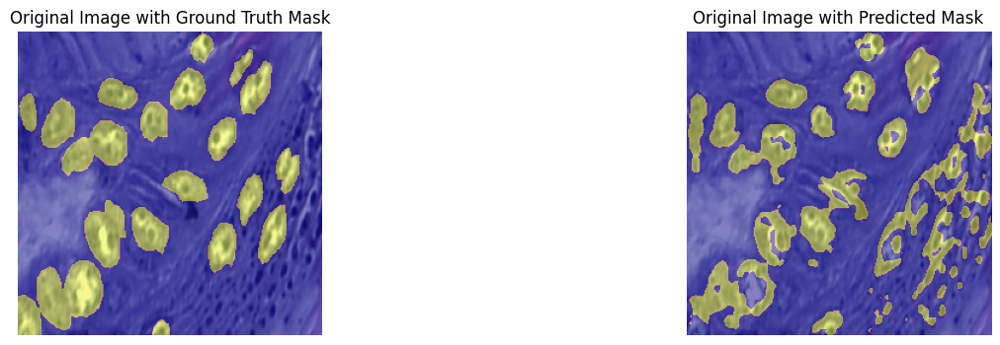

Epoch 9 Loss: 0.4256, Accuracy: 80.18%


Validation Loss: 0.3970, Validation Accuracy: 81.85%


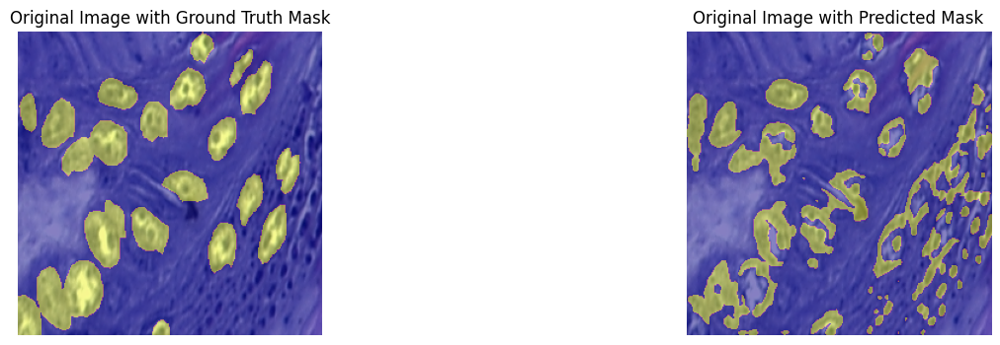

Epoch 10 Loss: 0.4236, Accuracy: 80.34%


Validation Loss: 0.3829, Validation Accuracy: 83.06%


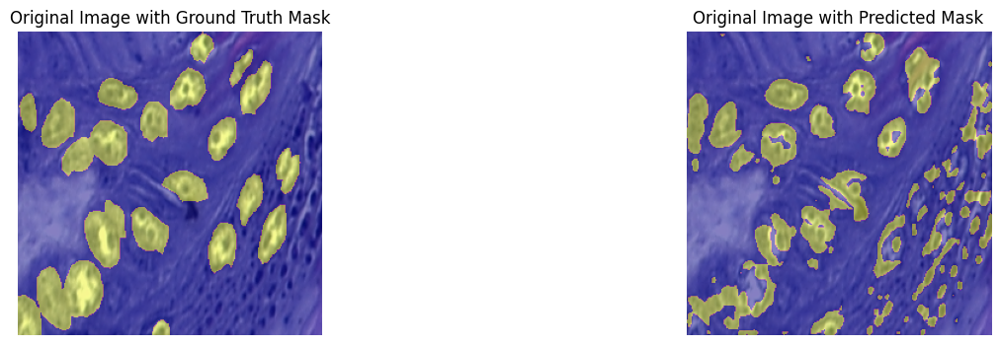

Epoch 11 Loss: 0.4159, Accuracy: 80.92%


Validation Loss: 0.3815, Validation Accuracy: 83.14%


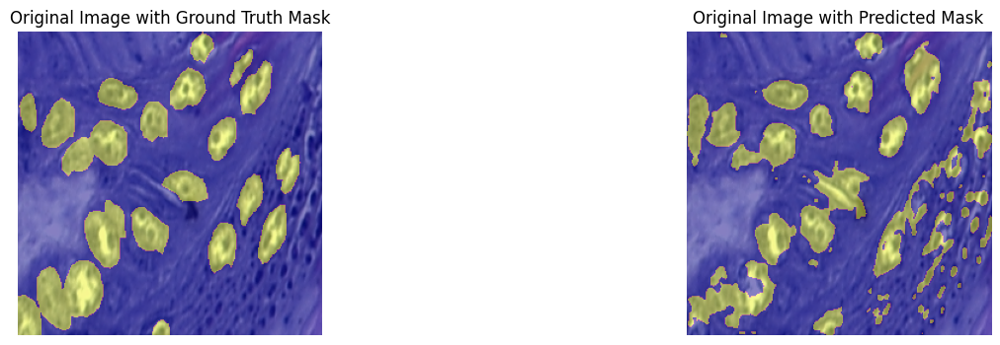

Epoch 12 Loss: 0.4129, Accuracy: 81.13%


Validation Loss: 0.4016, Validation Accuracy: 81.69%


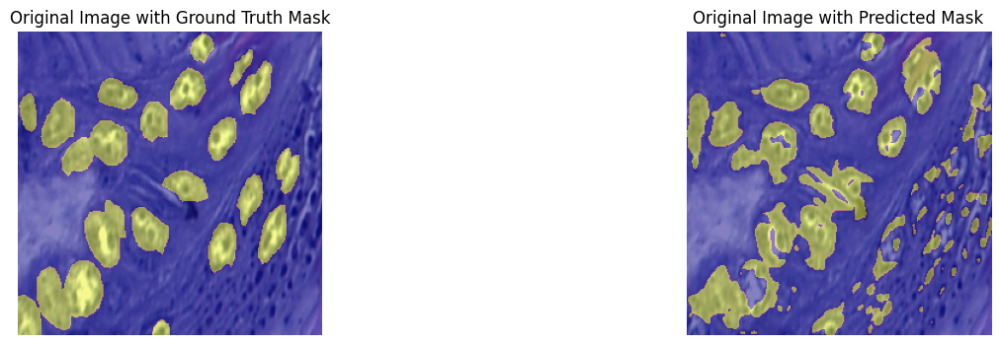

Epoch 13 Loss: 0.4175, Accuracy: 80.80%


Validation Loss: 0.3920, Validation Accuracy: 82.31%


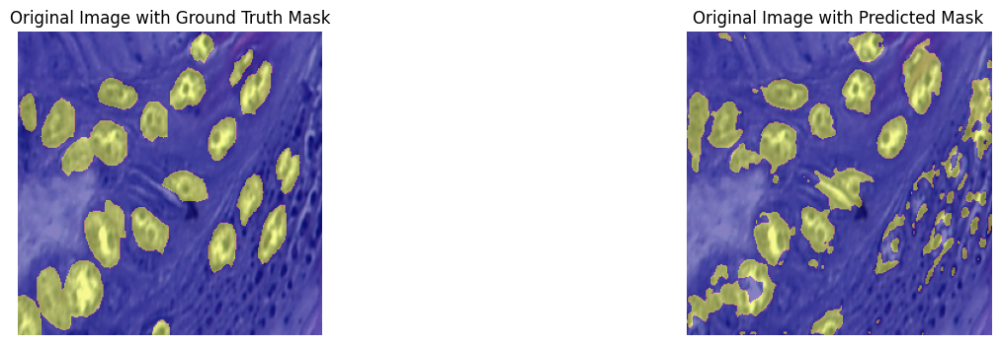

Epoch 14 Loss: 0.4144, Accuracy: 80.91%


Validation Loss: 0.3908, Validation Accuracy: 82.24%


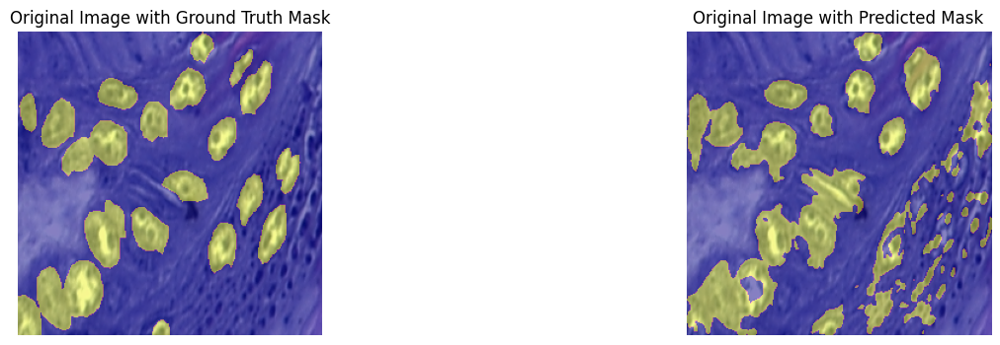

Epoch 15 Loss: 0.4059, Accuracy: 81.48%


Validation Loss: 0.3773, Validation Accuracy: 83.04%


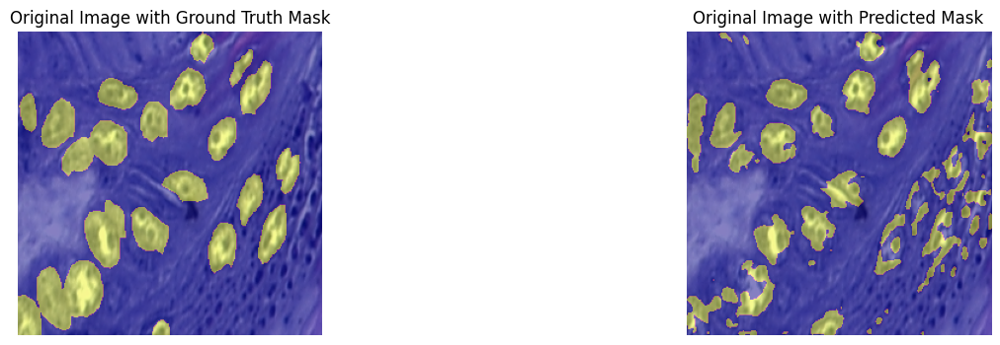

Epoch 16 Loss: 0.4005, Accuracy: 81.56%


Validation Loss: 0.3918, Validation Accuracy: 82.34%


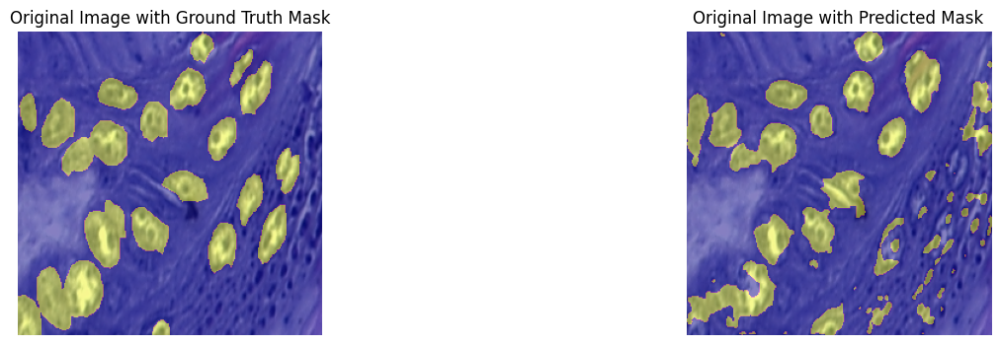

Epoch 17 Loss: 0.4054, Accuracy: 81.38%


Validation Loss: 0.4113, Validation Accuracy: 80.47%


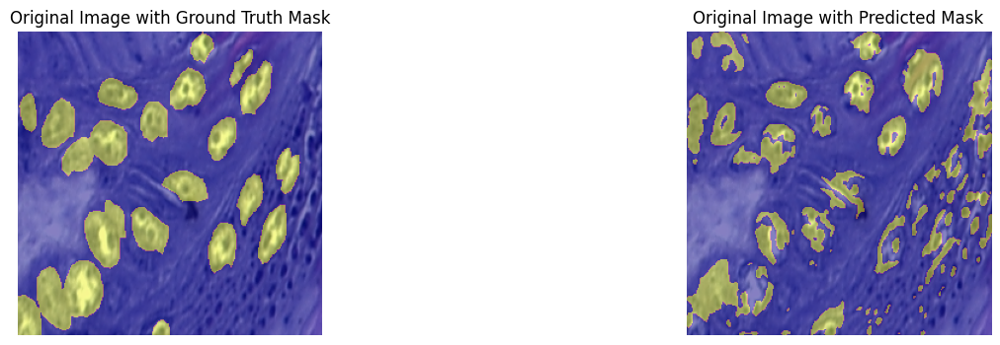

Epoch 18 Loss: 0.4178, Accuracy: 80.62%


Validation Loss: 0.3782, Validation Accuracy: 83.21%


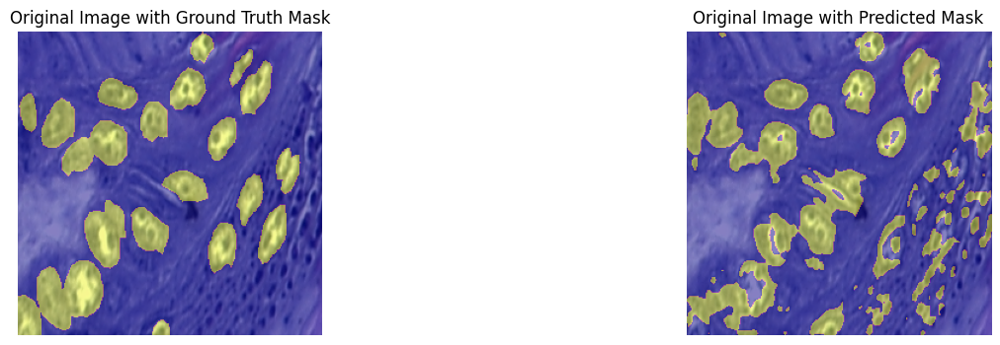

Epoch 19 Loss: 0.4062, Accuracy: 81.34%


Validation Loss: 0.3889, Validation Accuracy: 83.29%


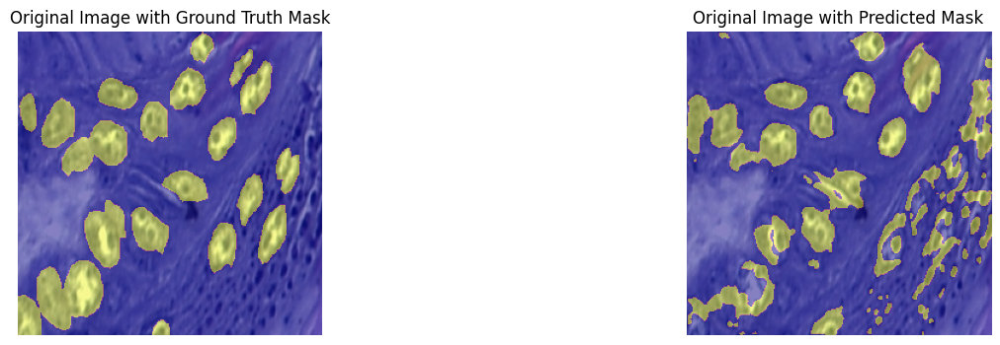

Epoch 20 Loss: 0.4052, Accuracy: 81.65%


Validation Loss: 0.3930, Validation Accuracy: 82.10%


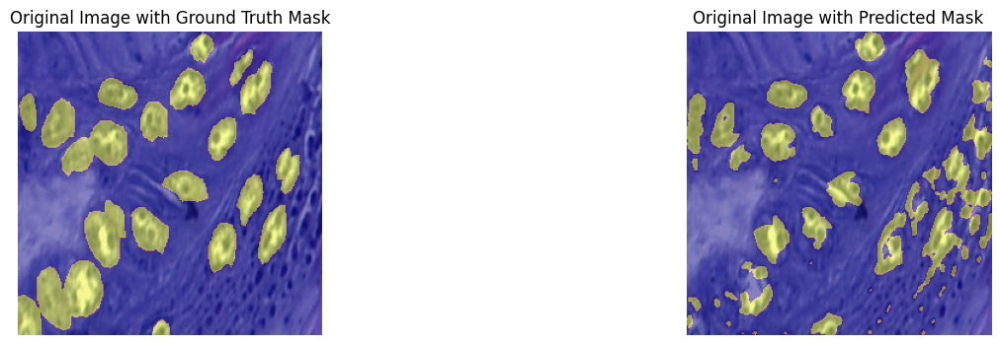

Epoch 21 Loss: 0.4076, Accuracy: 81.23%


Validation Loss: 0.3817, Validation Accuracy: 83.24%


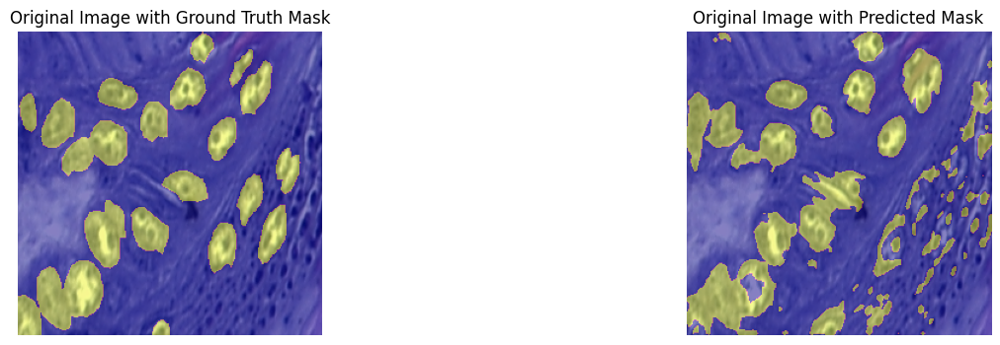

Epoch 22 Loss: 0.3977, Accuracy: 81.99%


Validation Loss: 0.3864, Validation Accuracy: 82.64%


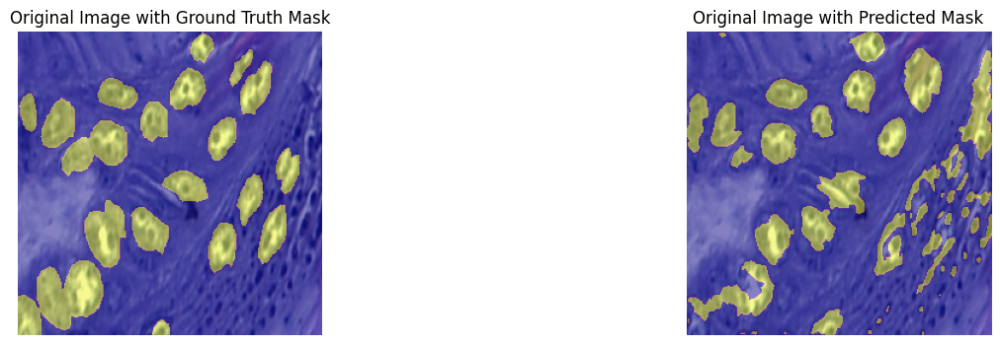

Epoch 23 Loss: 0.4087, Accuracy: 81.61%


Validation Loss: 0.3827, Validation Accuracy: 83.16%


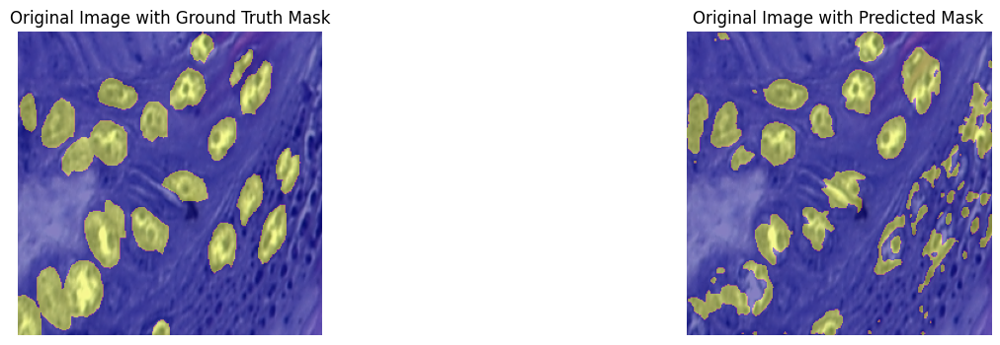

Epoch 24 Loss: 0.3974, Accuracy: 82.02%


Validation Loss: 0.3753, Validation Accuracy: 82.95%


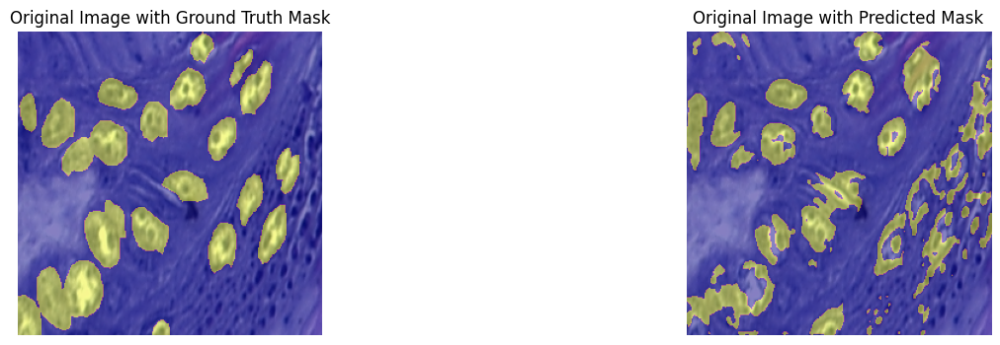

Epoch 25 Loss: 0.3890, Accuracy: 82.34%


Validation Loss: 0.3786, Validation Accuracy: 83.22%


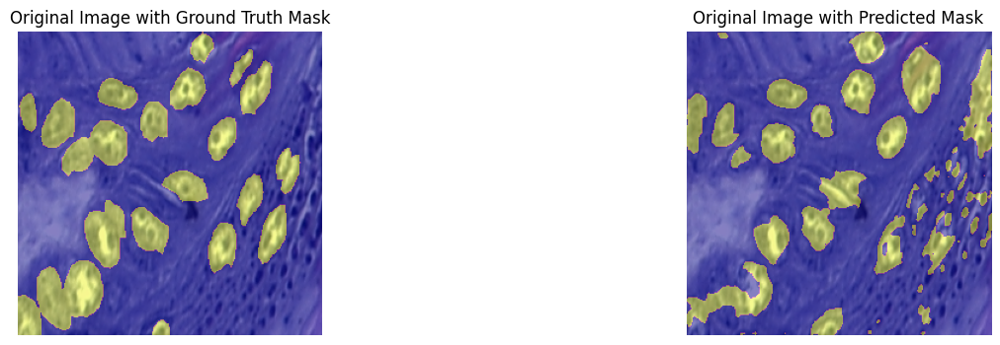

Epoch 26 Loss: 0.3896, Accuracy: 82.57%


Validation Loss: 0.3781, Validation Accuracy: 82.77%


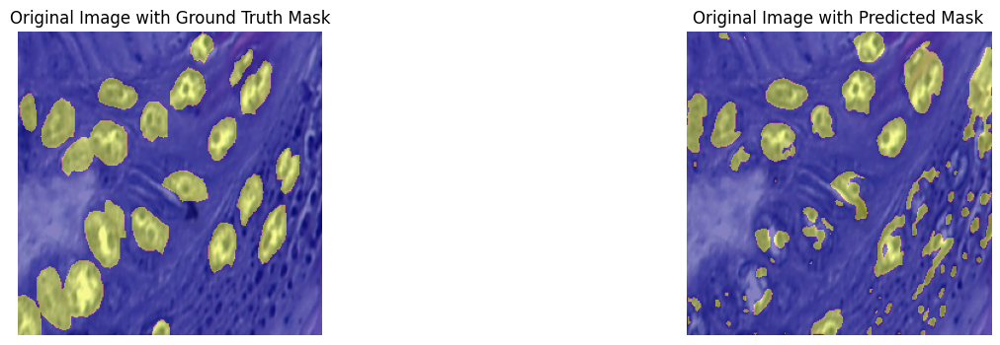

Epoch 27 Loss: 0.3962, Accuracy: 82.24%


Validation Loss: 0.3815, Validation Accuracy: 83.08%


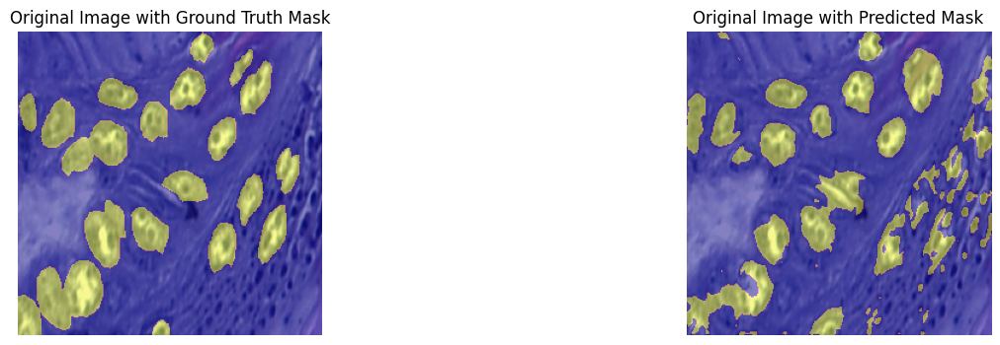

Epoch 28 Loss: 0.3937, Accuracy: 82.18%


Validation Loss: 0.3900, Validation Accuracy: 82.14%


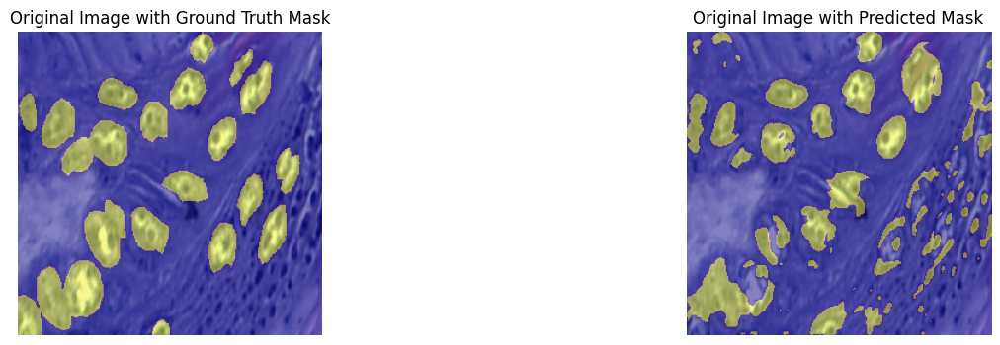

Epoch 29 Loss: 0.3886, Accuracy: 82.36%


Validation Loss: 0.3815, Validation Accuracy: 82.96%


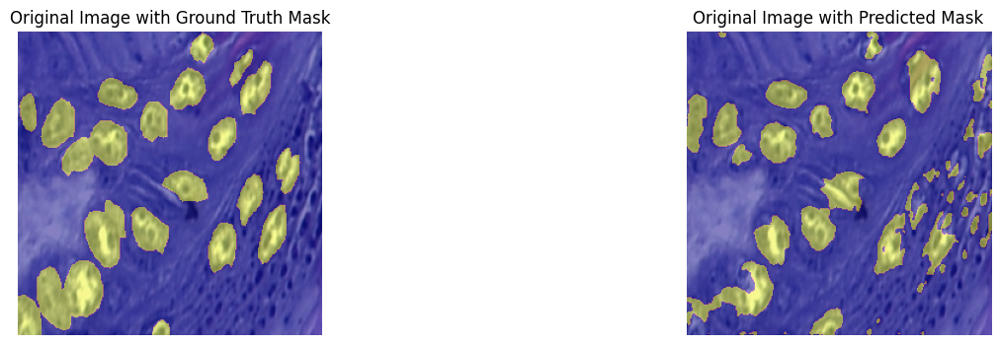

Epoch 30 Loss: 0.3839, Accuracy: 82.84%


Validation Loss: 0.3689, Validation Accuracy: 83.93%


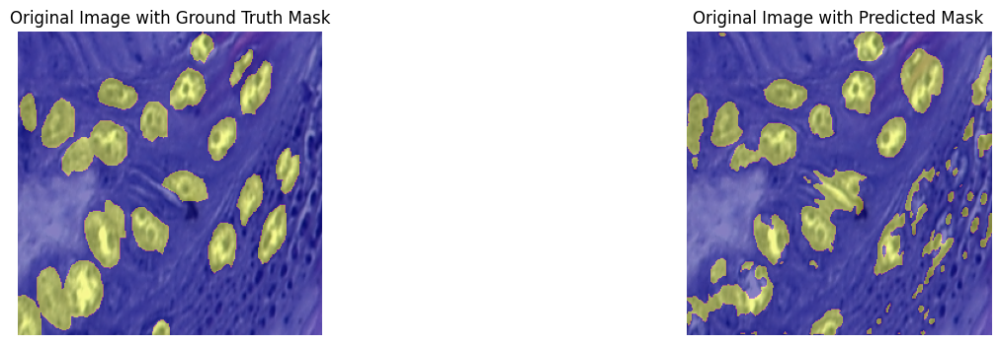

Epoch 31 Loss: 0.3965, Accuracy: 82.04%


Validation Loss: 0.3691, Validation Accuracy: 83.23%


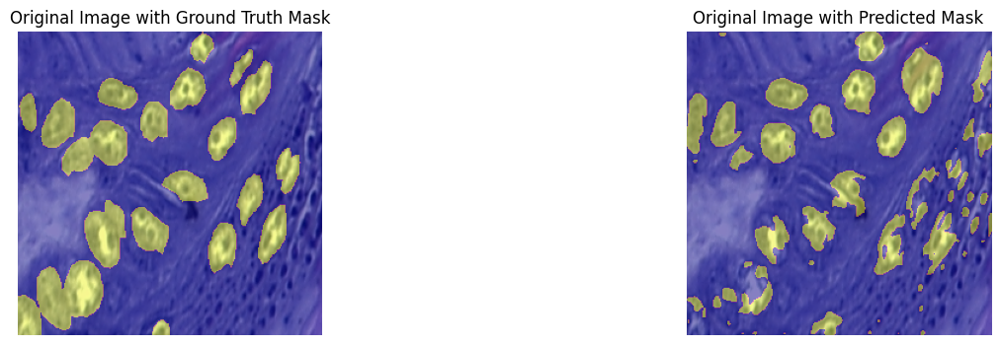

Epoch 32 Loss: 0.3828, Accuracy: 82.73%


Validation Loss: 0.3738, Validation Accuracy: 83.30%


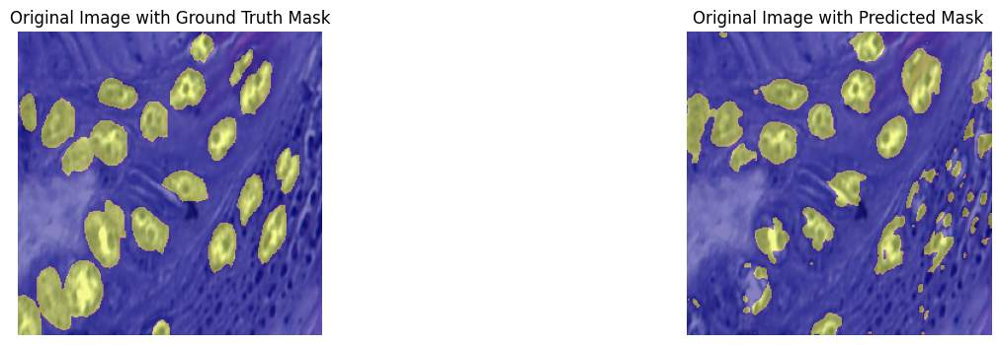

Epoch 33 Loss: 0.3966, Accuracy: 82.17%


Validation Loss: 0.3666, Validation Accuracy: 83.96%


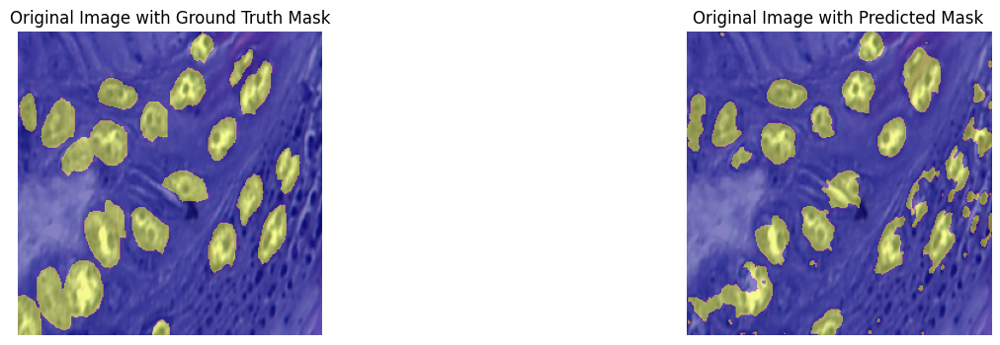

Epoch 34 Loss: 0.3875, Accuracy: 82.62%


Validation Loss: 0.3626, Validation Accuracy: 83.95%


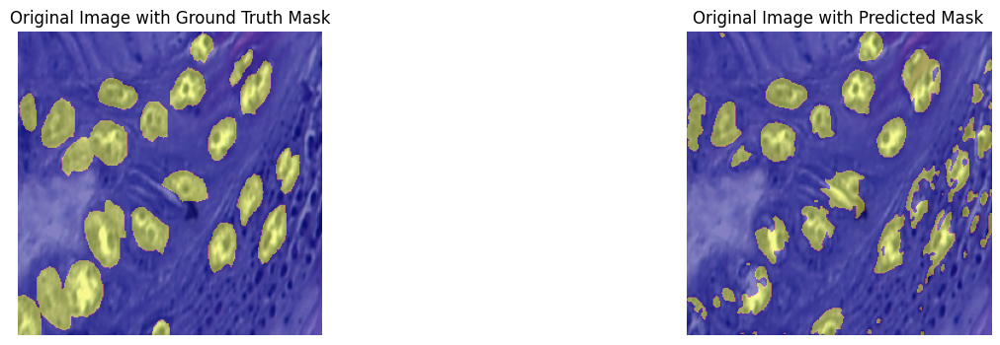

Epoch 35 Loss: 0.3775, Accuracy: 83.12%


Validation Loss: 0.3869, Validation Accuracy: 82.27%


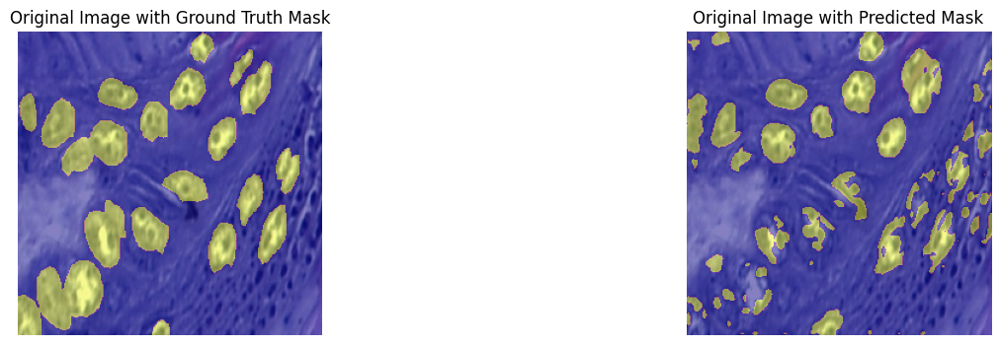

Epoch 36 Loss: 0.3719, Accuracy: 83.28%


Validation Loss: 0.3822, Validation Accuracy: 82.49%


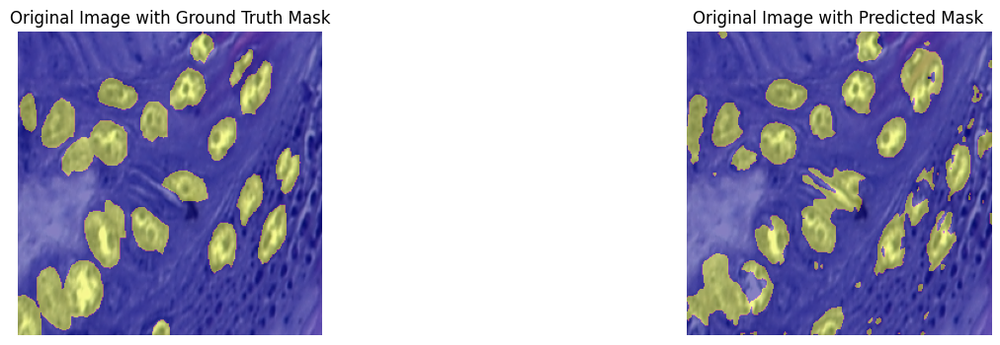

Epoch 37 Loss: 0.3675, Accuracy: 83.62%


Validation Loss: 0.3571, Validation Accuracy: 84.15%


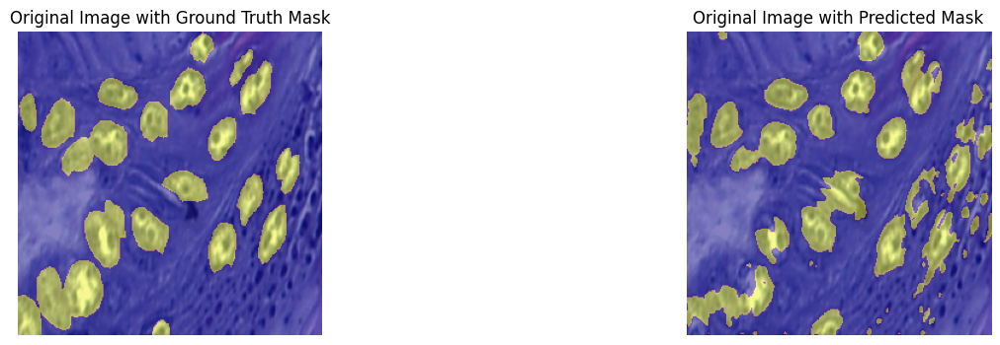

Epoch 38 Loss: 0.3653, Accuracy: 83.73%


Validation Loss: 0.3639, Validation Accuracy: 83.83%


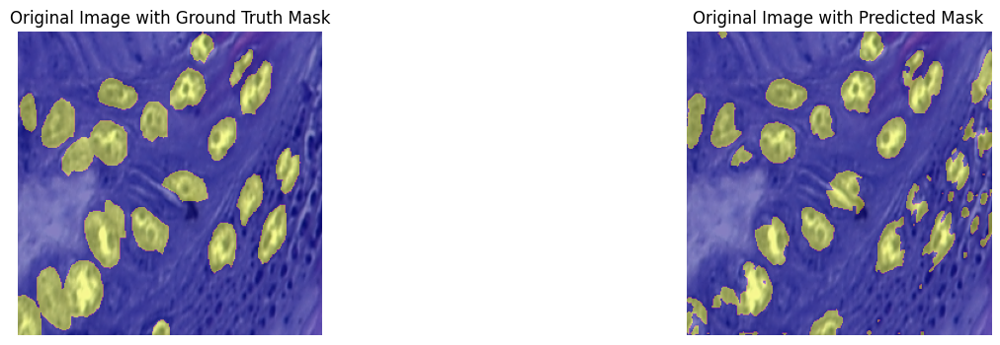

Epoch 39 Loss: 0.3643, Accuracy: 83.91%


Validation Loss: 0.3730, Validation Accuracy: 83.87%


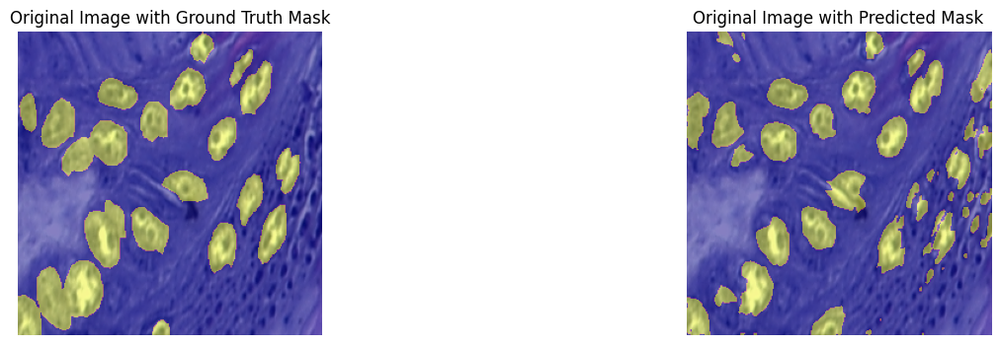

Epoch 40 Loss: 0.3755, Accuracy: 83.32%


Validation Loss: 0.3805, Validation Accuracy: 83.21%


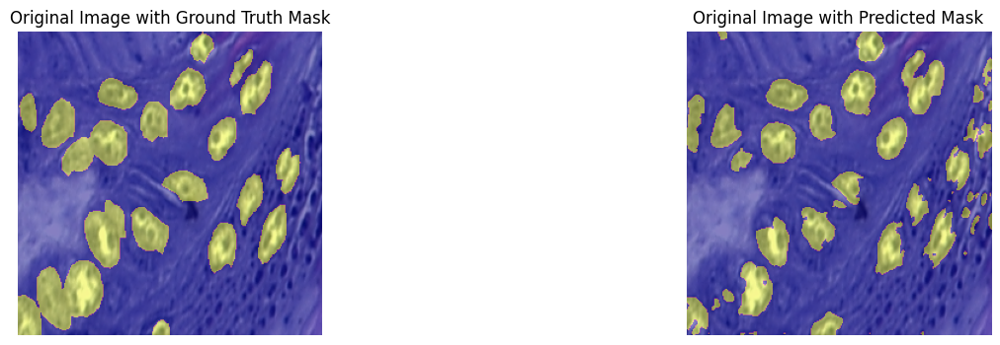

Epoch 41 Loss: 0.3632, Accuracy: 83.94%


Validation Loss: 0.3515, Validation Accuracy: 84.77%


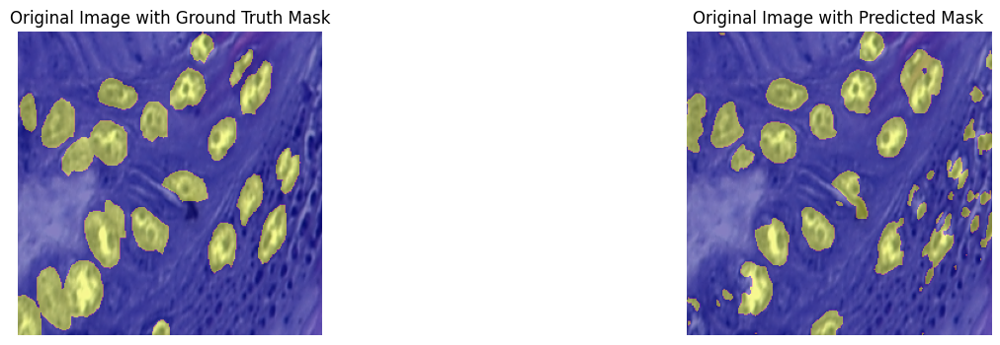

Epoch 42 Loss: 0.3664, Accuracy: 83.69%


Validation Loss: 0.3590, Validation Accuracy: 84.30%


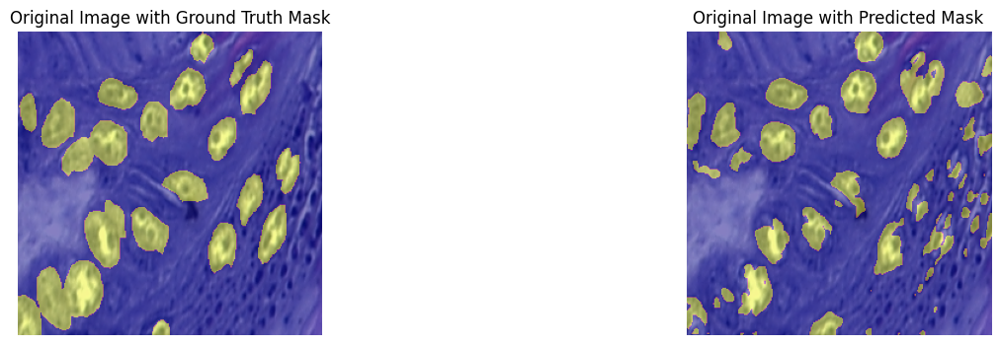

Epoch 43 Loss: 0.3604, Accuracy: 84.29%


Validation Loss: 0.3584, Validation Accuracy: 84.30%


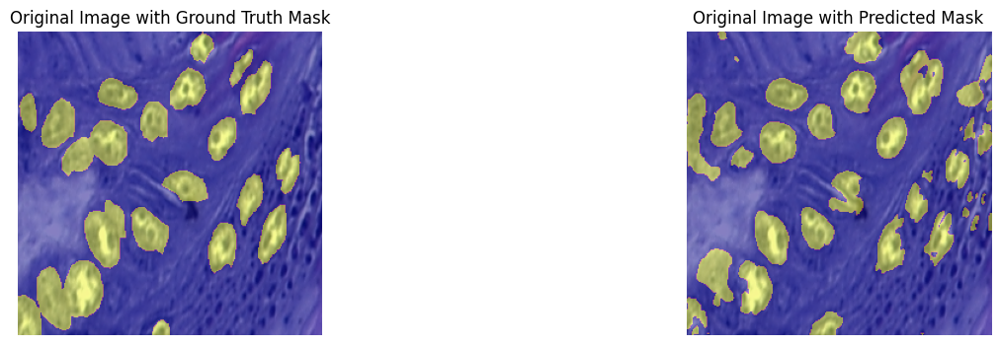

Epoch 44 Loss: 0.3533, Accuracy: 84.43%


Validation Loss: 0.3530, Validation Accuracy: 84.34%


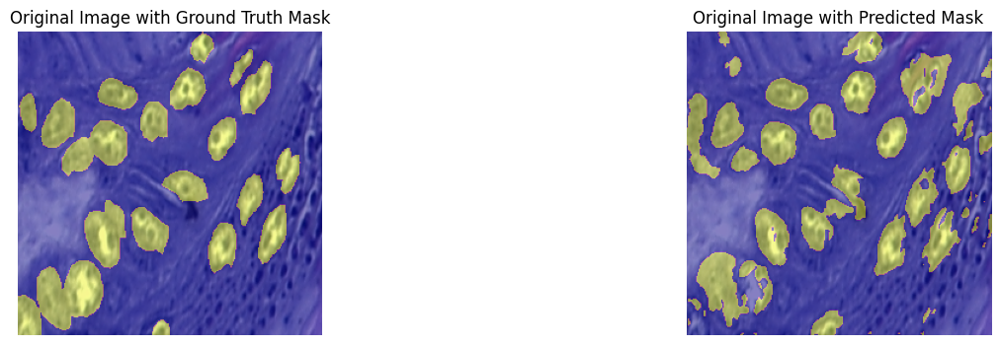

Epoch 45 Loss: 0.3512, Accuracy: 84.51%


Validation Loss: 0.3648, Validation Accuracy: 83.79%


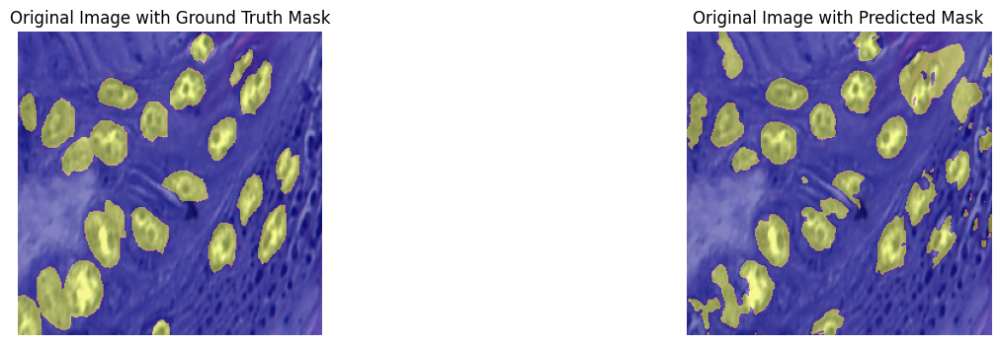

Epoch 46 Loss: 0.3411, Accuracy: 85.10%


Validation Loss: 0.3490, Validation Accuracy: 84.83%


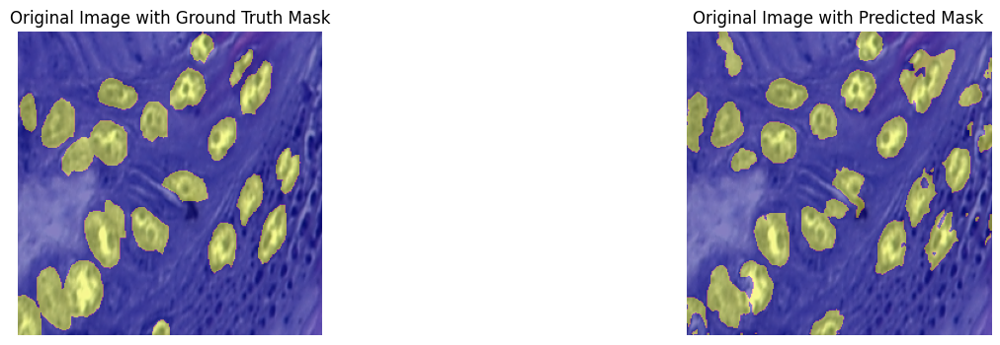

Epoch 47 Loss: 0.3392, Accuracy: 85.09%


Validation Loss: 0.3445, Validation Accuracy: 84.85%


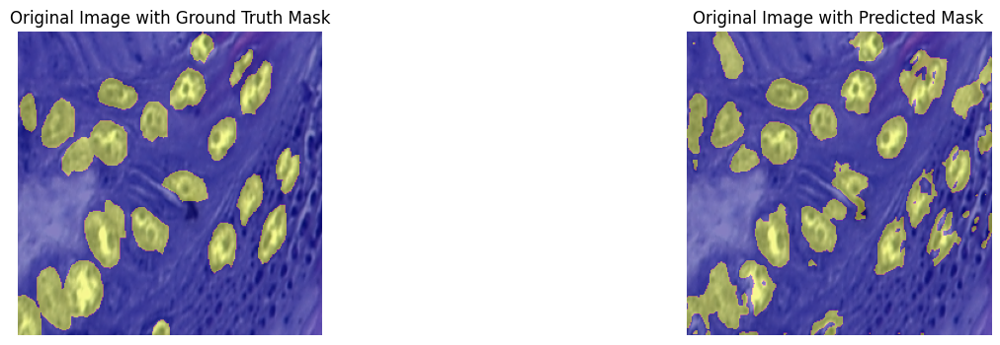

Epoch 48 Loss: 0.3451, Accuracy: 85.01%


Validation Loss: 0.3266, Validation Accuracy: 86.06%


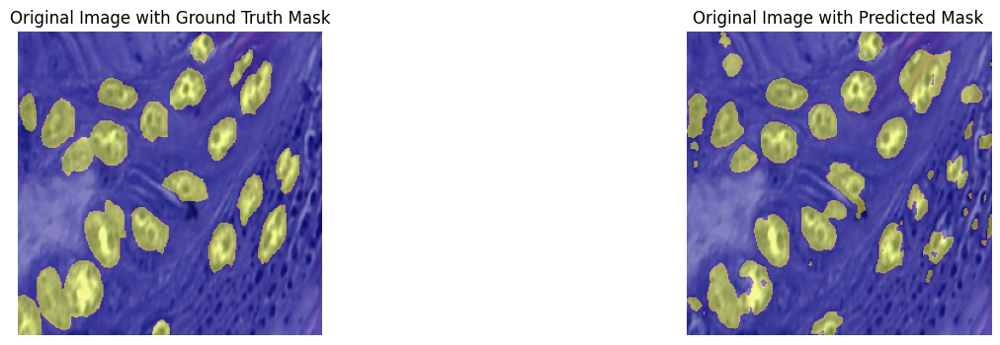

Epoch 49 Loss: 0.3374, Accuracy: 85.29%


Validation Loss: 0.3557, Validation Accuracy: 84.81%


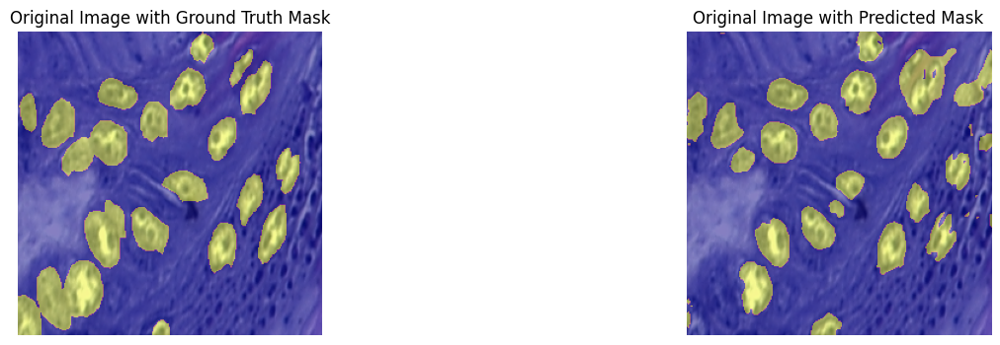

Epoch 50 Loss: 0.3397, Accuracy: 85.01%


Validation Loss: 0.3368, Validation Accuracy: 85.53%


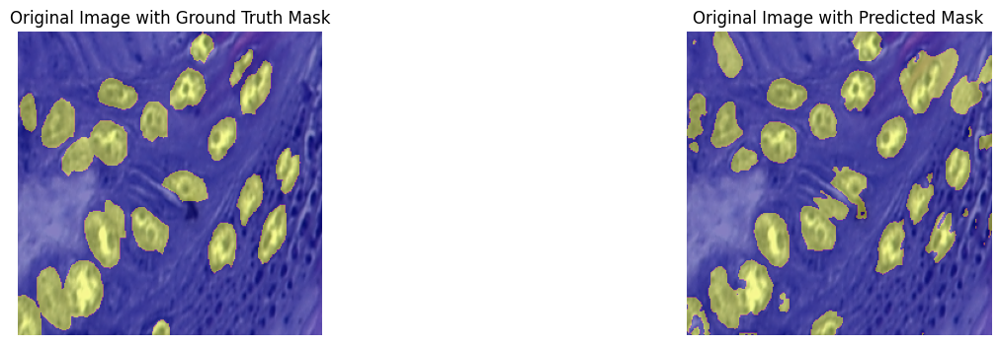

Epoch 51 Loss: 0.3473, Accuracy: 84.62%


Validation Loss: 0.3262, Validation Accuracy: 85.85%


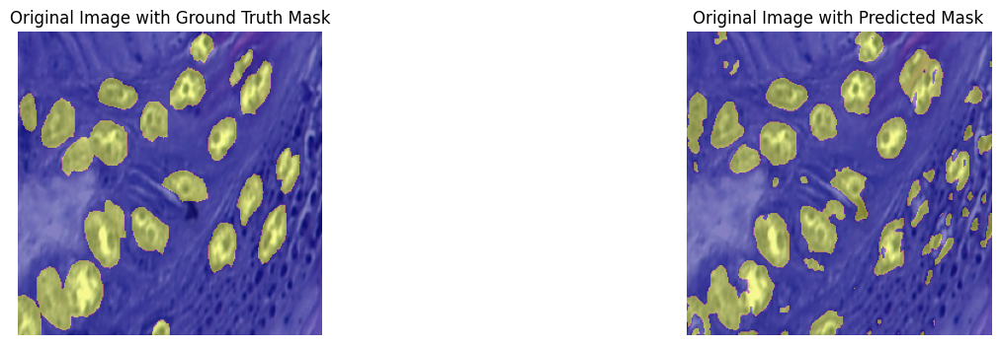

Epoch 52 Loss: 0.3460, Accuracy: 84.80%


Validation Loss: 0.3461, Validation Accuracy: 85.09%


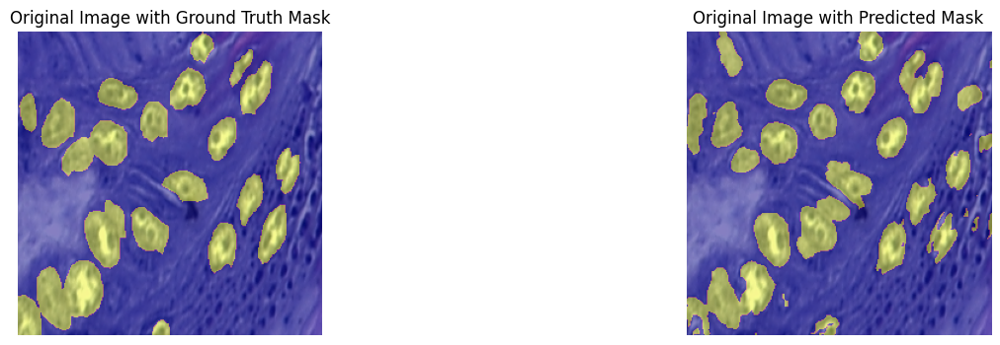

Epoch 53 Loss: 0.3317, Accuracy: 85.47%


Validation Loss: 0.3180, Validation Accuracy: 86.65%


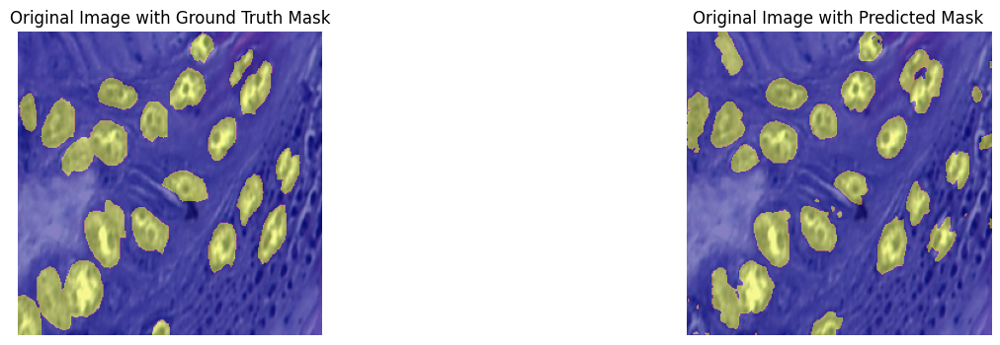

Epoch 54 Loss: 0.3290, Accuracy: 85.74%


Validation Loss: 0.3515, Validation Accuracy: 84.36%


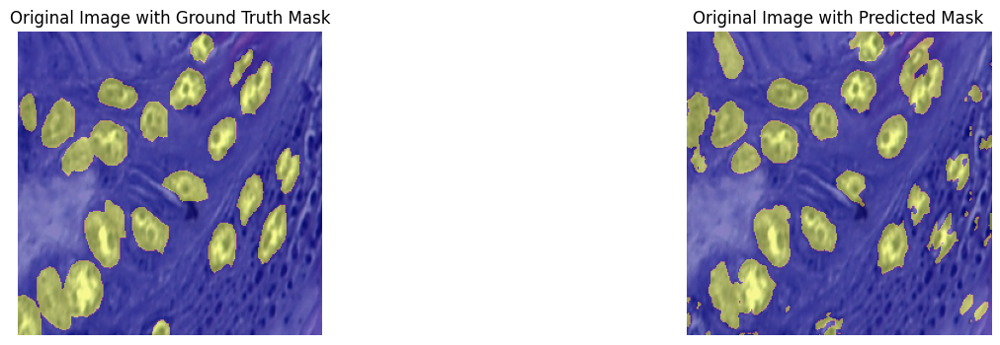

Epoch 55 Loss: 0.3300, Accuracy: 85.63%


Validation Loss: 0.3066, Validation Accuracy: 87.21%


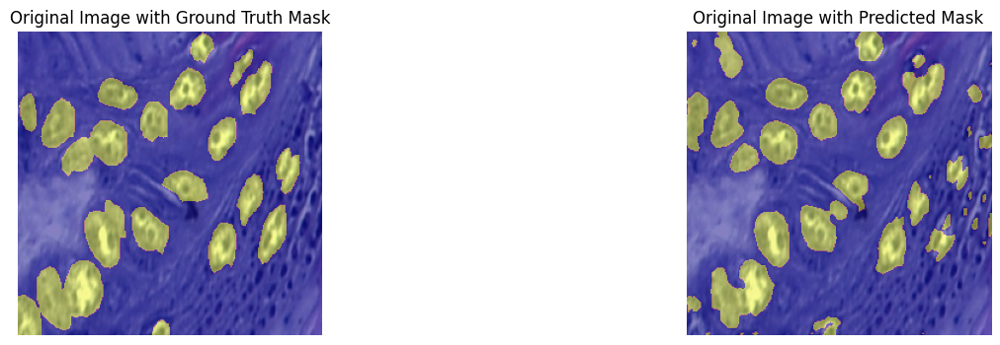

Epoch 56 Loss: 0.3274, Accuracy: 85.69%


Validation Loss: 0.3266, Validation Accuracy: 86.24%


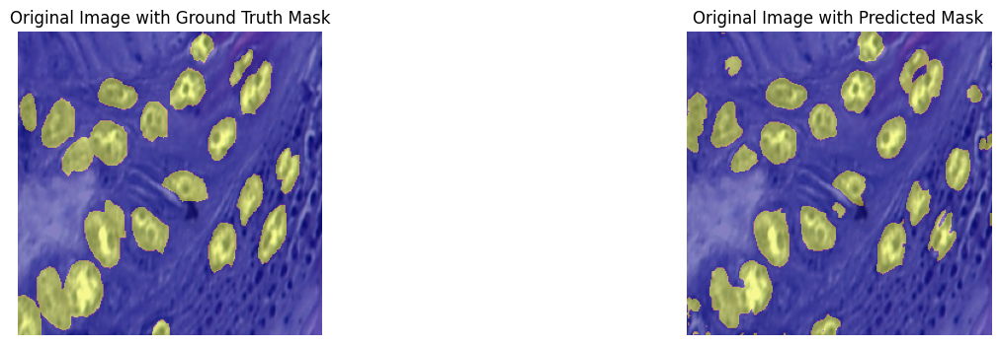

Epoch 57 Loss: 0.3230, Accuracy: 86.09%


Validation Loss: 0.3094, Validation Accuracy: 87.01%


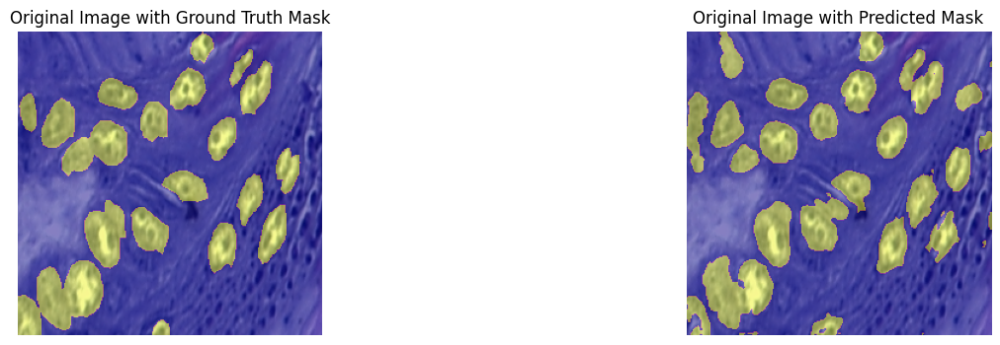

Epoch 58 Loss: 0.3259, Accuracy: 85.54%


Validation Loss: 0.3366, Validation Accuracy: 85.20%


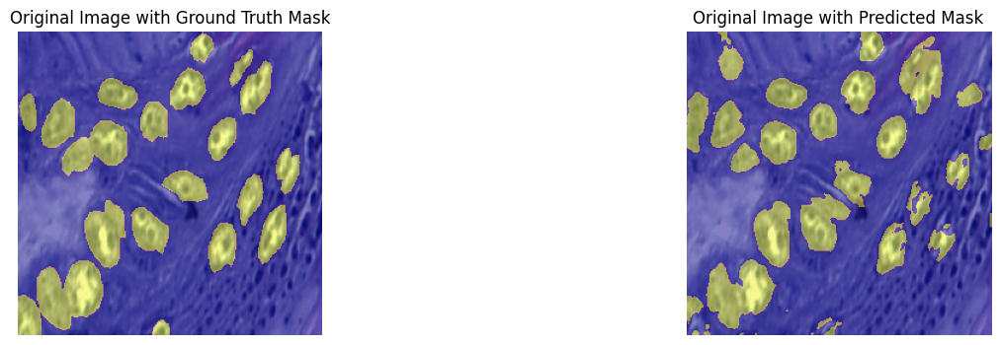

Epoch 59 Loss: 0.3308, Accuracy: 85.45%


Validation Loss: 0.3238, Validation Accuracy: 86.33%


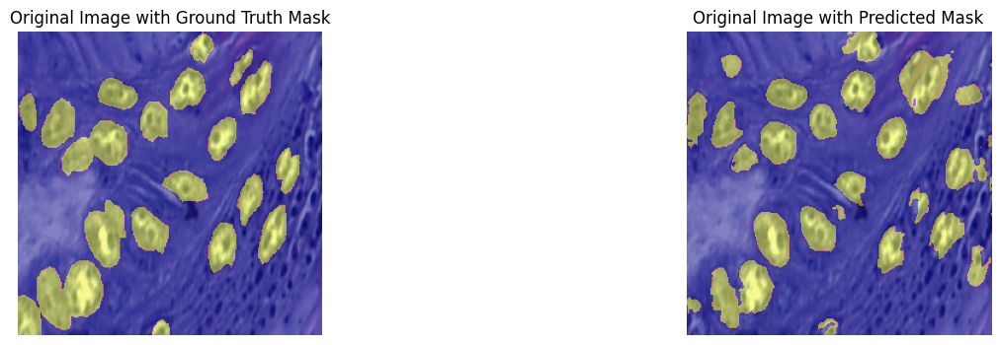

Epoch 60 Loss: 0.3188, Accuracy: 86.31%


Validation Loss: 0.3161, Validation Accuracy: 86.61%


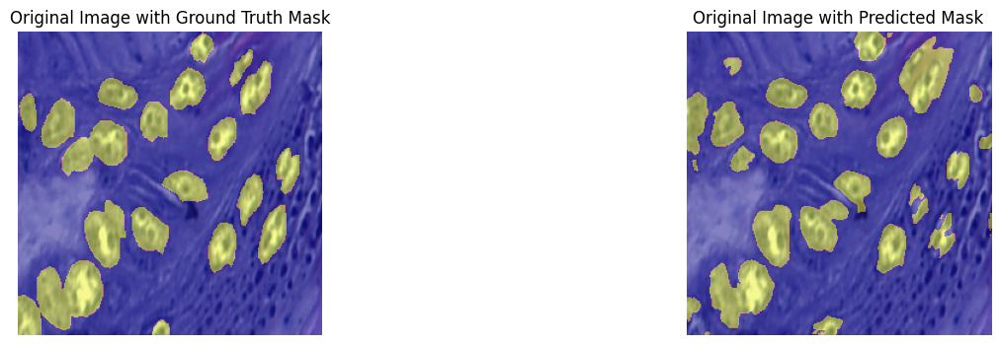

Epoch 61 Loss: 0.3243, Accuracy: 85.87%


Validation Loss: 0.3057, Validation Accuracy: 87.33%


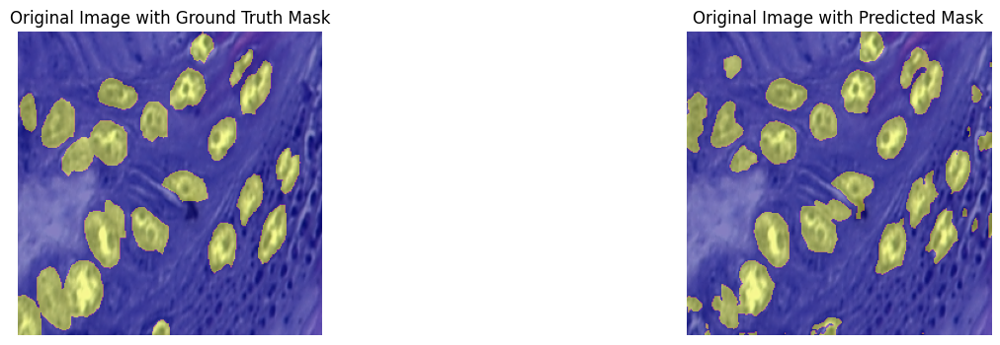

Epoch 62 Loss: 0.3142, Accuracy: 86.32%


Validation Loss: 0.3160, Validation Accuracy: 86.51%


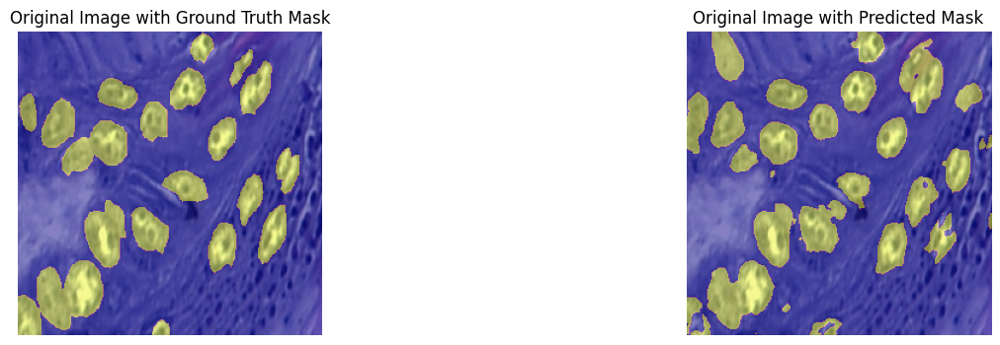

Epoch 63 Loss: 0.3158, Accuracy: 86.35%


Validation Loss: 0.3013, Validation Accuracy: 87.42%


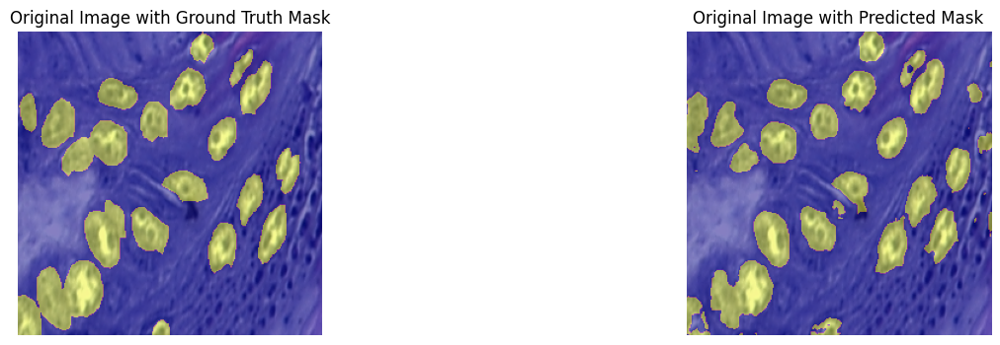

Epoch 64 Loss: 0.3099, Accuracy: 86.54%


Validation Loss: 0.2931, Validation Accuracy: 87.88%


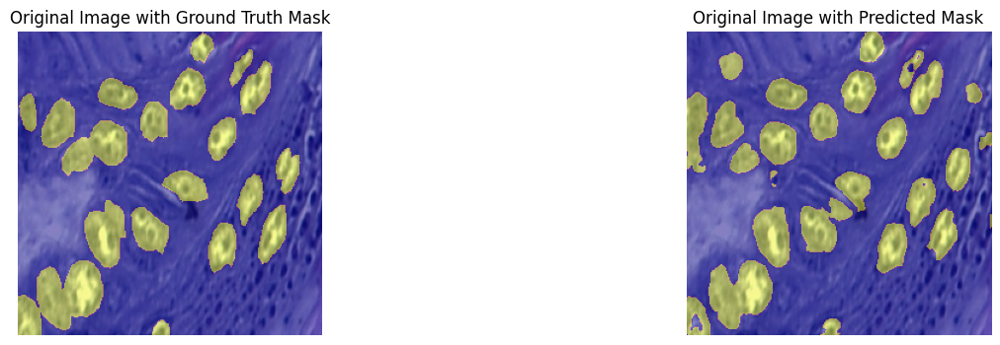

Epoch 65 Loss: 0.3104, Accuracy: 86.49%


Validation Loss: 0.2989, Validation Accuracy: 87.38%


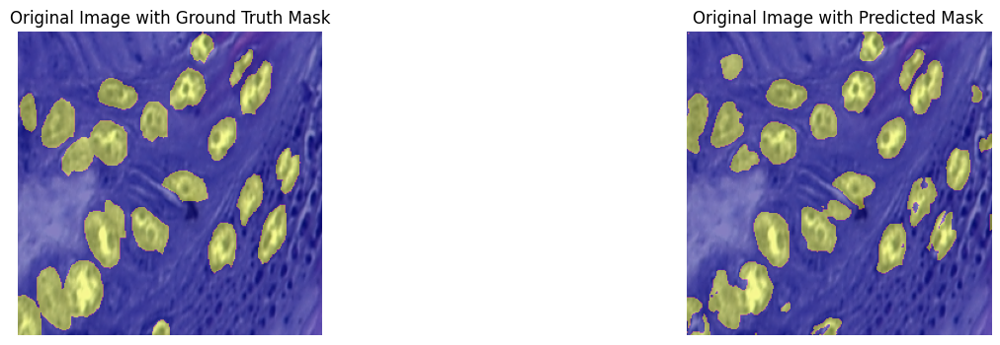

Epoch 66 Loss: 0.3219, Accuracy: 86.19%


Validation Loss: 0.2974, Validation Accuracy: 87.49%


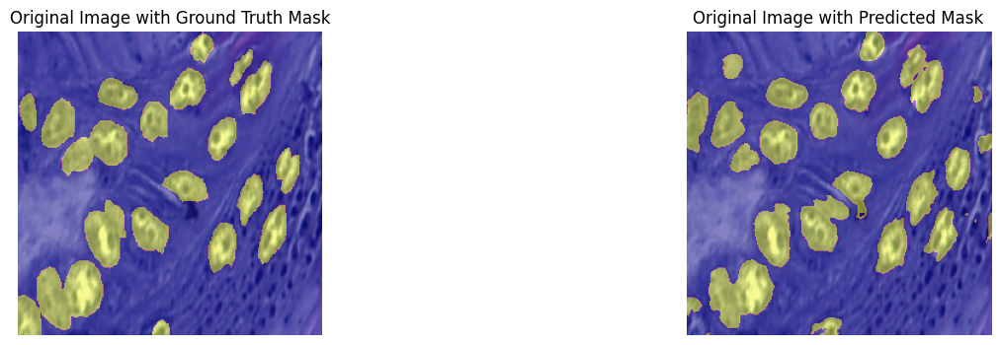

Epoch 67 Loss: 0.3053, Accuracy: 86.78%


Validation Loss: 0.3100, Validation Accuracy: 86.82%


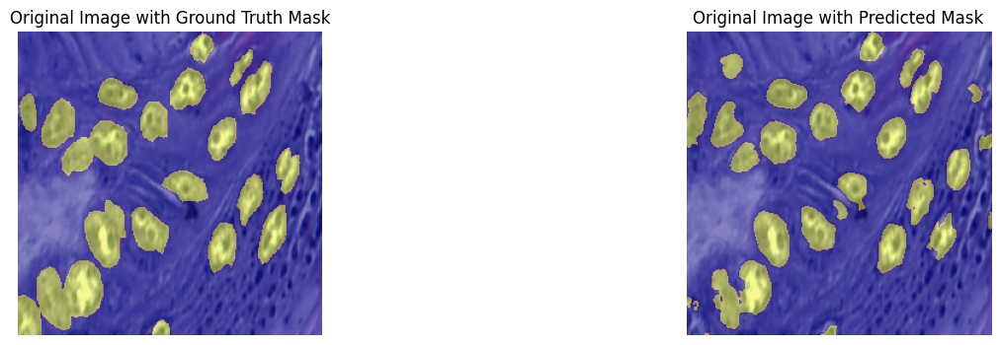

Epoch 68 Loss: 0.3101, Accuracy: 86.67%


Validation Loss: 0.2972, Validation Accuracy: 87.48%


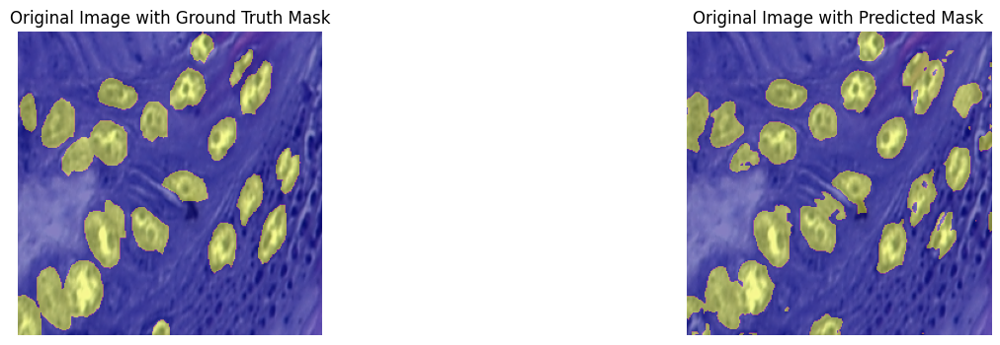

Epoch 69 Loss: 0.3117, Accuracy: 86.40%


Validation Loss: 0.3149, Validation Accuracy: 86.46%


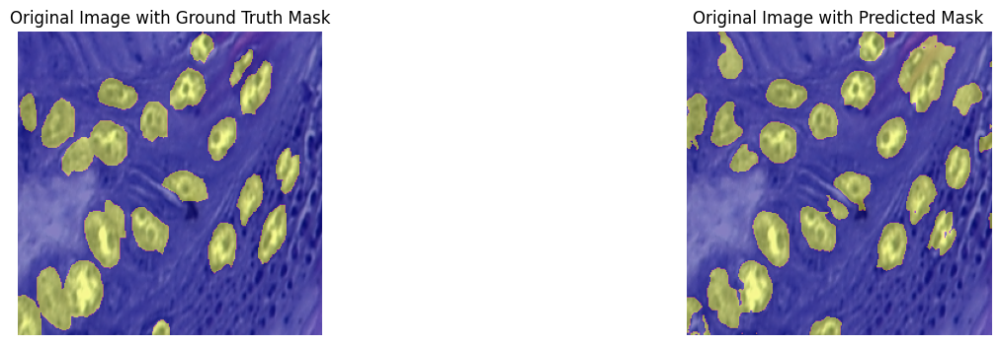

Epoch 70 Loss: 0.3021, Accuracy: 86.90%


Validation Loss: 0.3104, Validation Accuracy: 86.87%


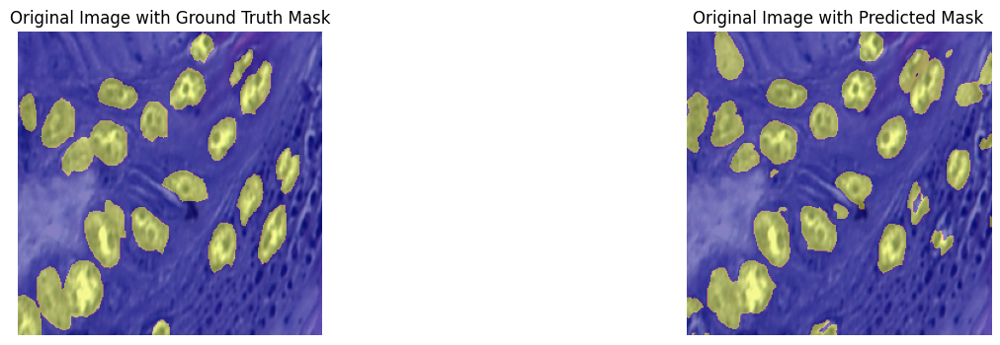

Epoch 71 Loss: 0.3043, Accuracy: 86.88%


Validation Loss: 0.3040, Validation Accuracy: 87.41%


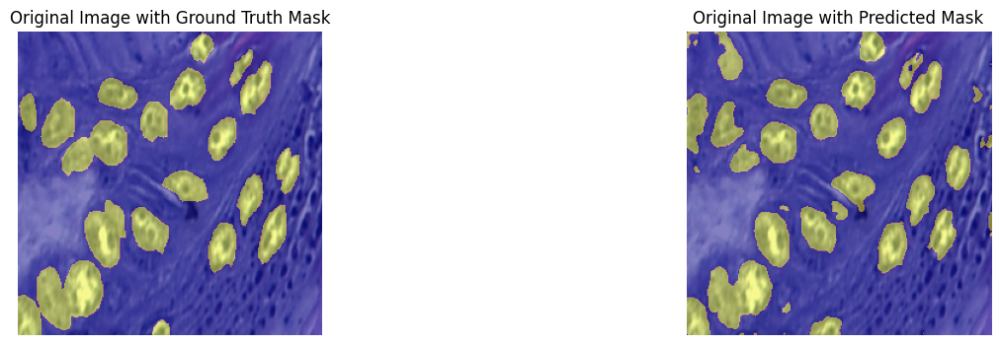

Epoch 72 Loss: 0.3044, Accuracy: 86.75%


Validation Loss: 0.3039, Validation Accuracy: 87.32%


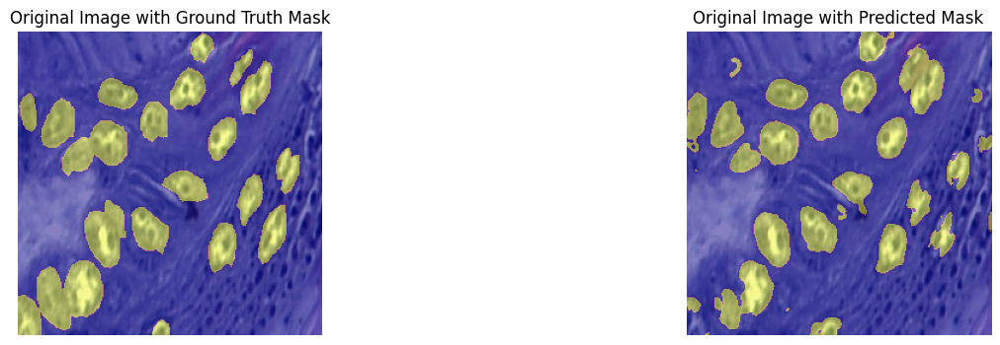

Epoch 73 Loss: 0.3037, Accuracy: 86.78%


Validation Loss: 0.3074, Validation Accuracy: 86.97%


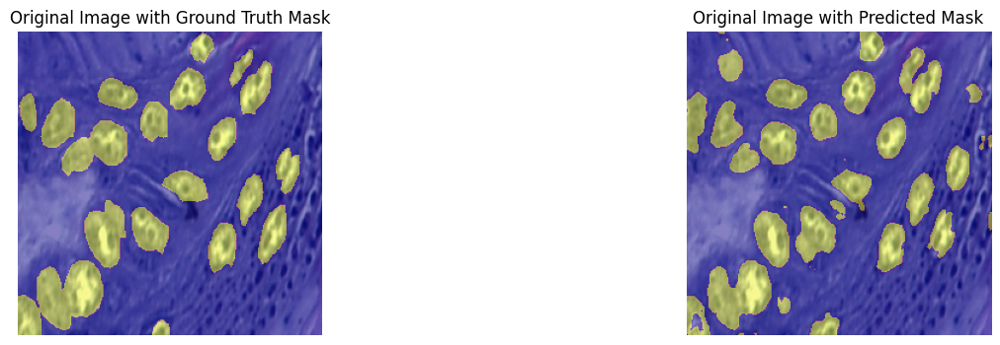

Epoch 74 Loss: 0.3100, Accuracy: 86.66%


Validation Loss: 0.3043, Validation Accuracy: 87.29%


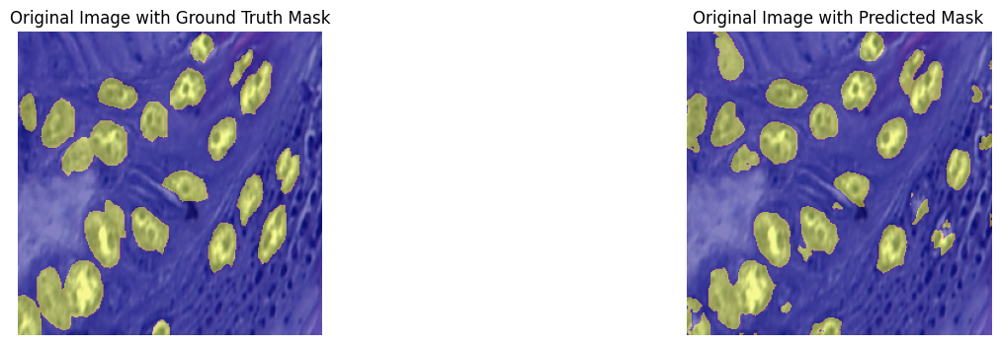

Epoch 75 Loss: 0.3000, Accuracy: 87.05%


Validation Loss: 0.3088, Validation Accuracy: 87.17%


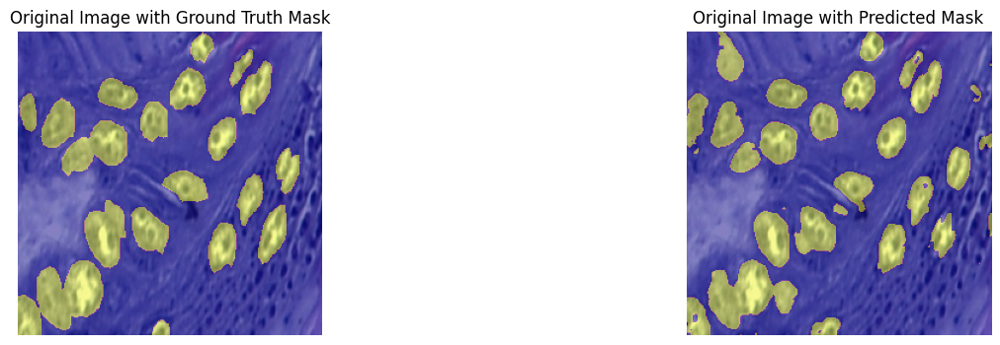

Epoch 76 Loss: 0.2987, Accuracy: 87.02%


Validation Loss: 0.3124, Validation Accuracy: 87.09%


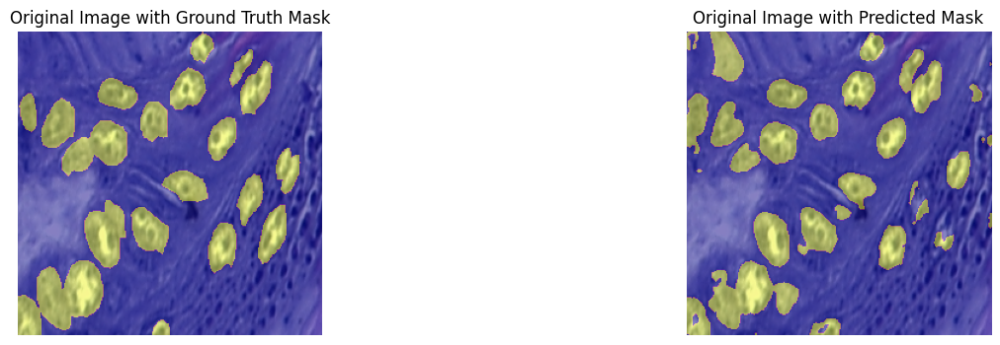

Epoch 77 Loss: 0.2932, Accuracy: 87.20%


Validation Loss: 0.2918, Validation Accuracy: 87.77%


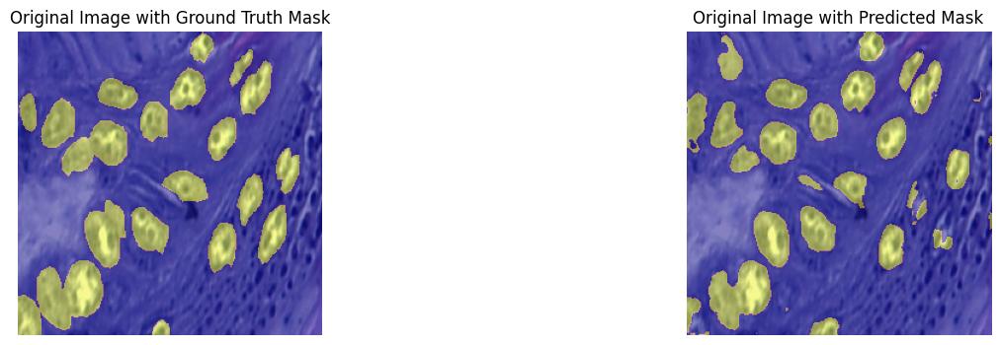

Epoch 78 Loss: 0.3014, Accuracy: 87.04%


Validation Loss: 0.2889, Validation Accuracy: 88.11%


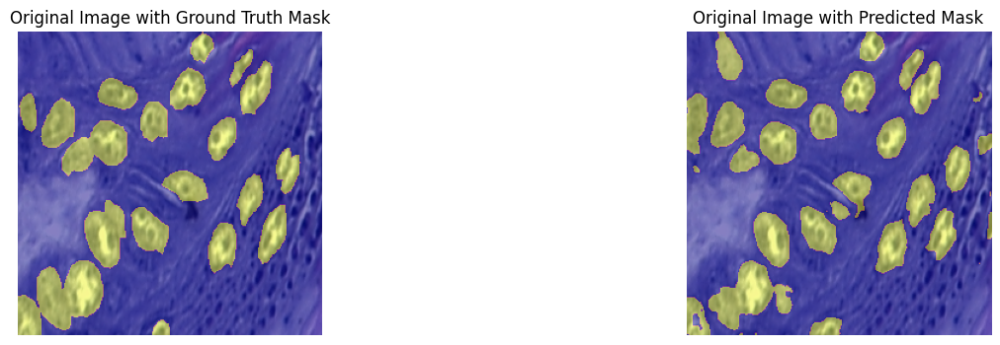

Epoch 79 Loss: 0.2989, Accuracy: 87.09%


Validation Loss: 0.2897, Validation Accuracy: 87.81%


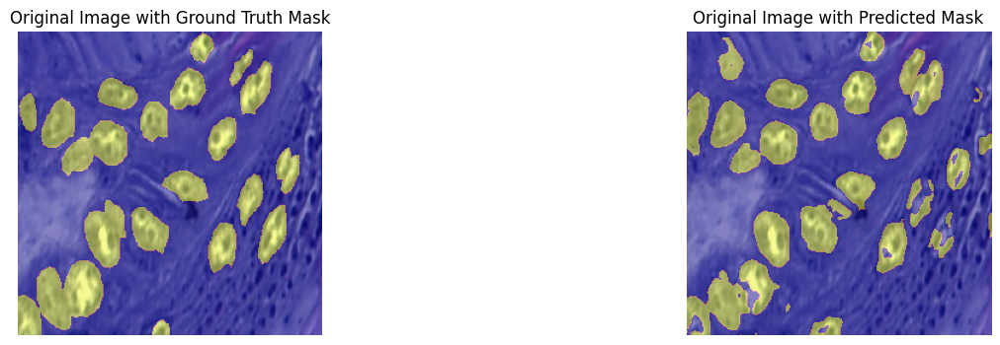

Epoch 80 Loss: 0.2976, Accuracy: 87.08%


Validation Loss: 0.3030, Validation Accuracy: 87.31%


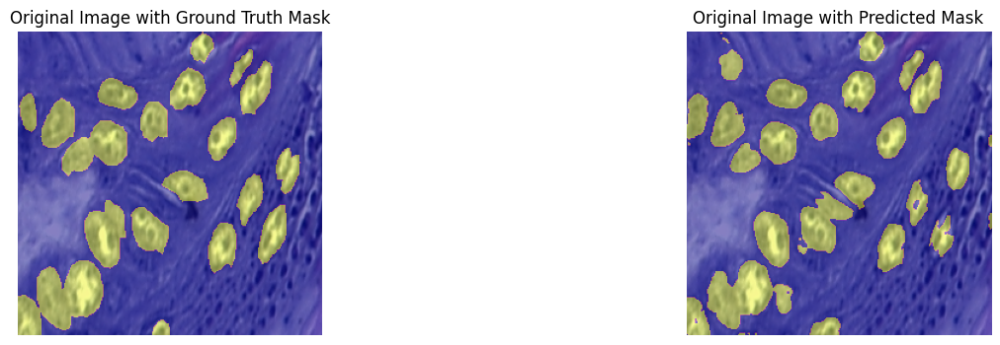

Epoch 81 Loss: 0.2945, Accuracy: 87.33%


Validation Loss: 0.2851, Validation Accuracy: 88.18%


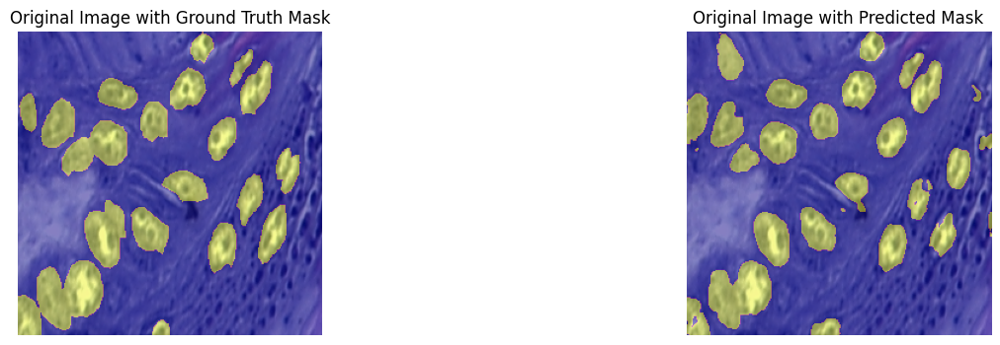

Epoch 82 Loss: 0.2950, Accuracy: 87.30%


Validation Loss: 0.2895, Validation Accuracy: 88.18%


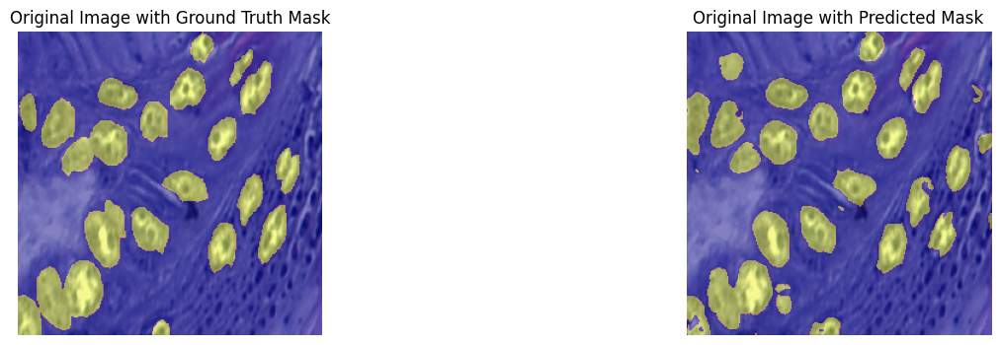

Epoch 83 Loss: 0.2914, Accuracy: 87.15%


Validation Loss: 0.2938, Validation Accuracy: 87.63%


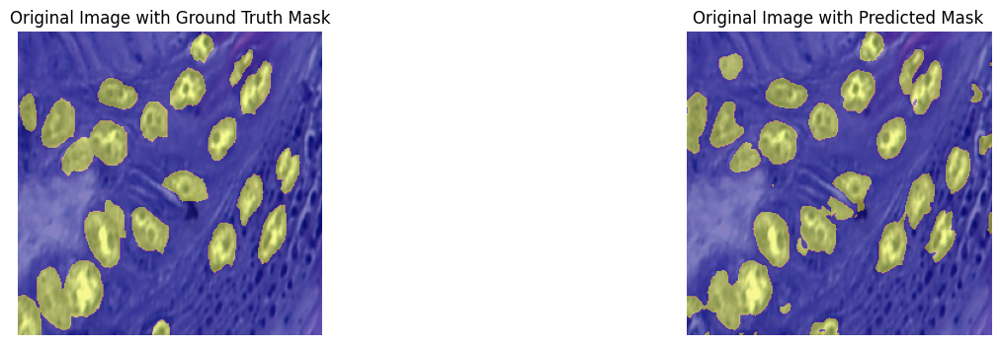

Epoch 84 Loss: 0.2904, Accuracy: 87.46%


Validation Loss: 0.3067, Validation Accuracy: 87.15%


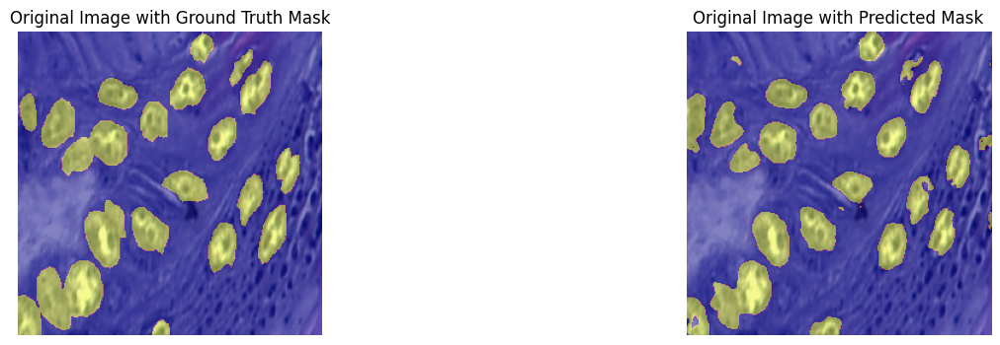

Epoch 85 Loss: 0.2932, Accuracy: 87.39%


Validation Loss: 0.3016, Validation Accuracy: 87.78%


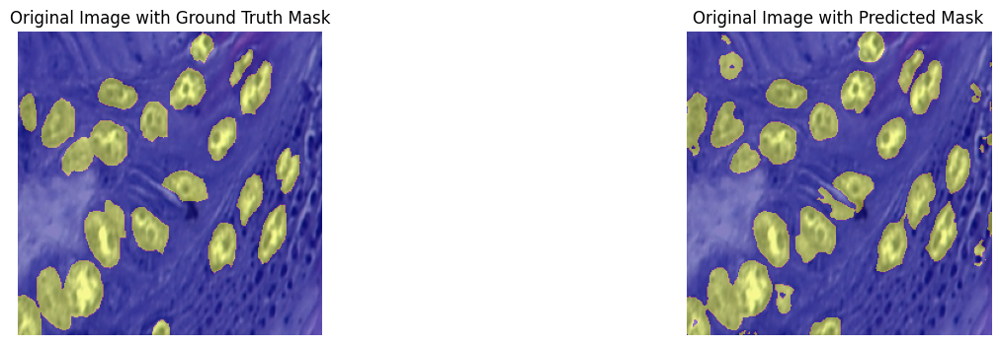

Epoch 86 Loss: 0.2897, Accuracy: 87.36%


Validation Loss: 0.3062, Validation Accuracy: 87.17%


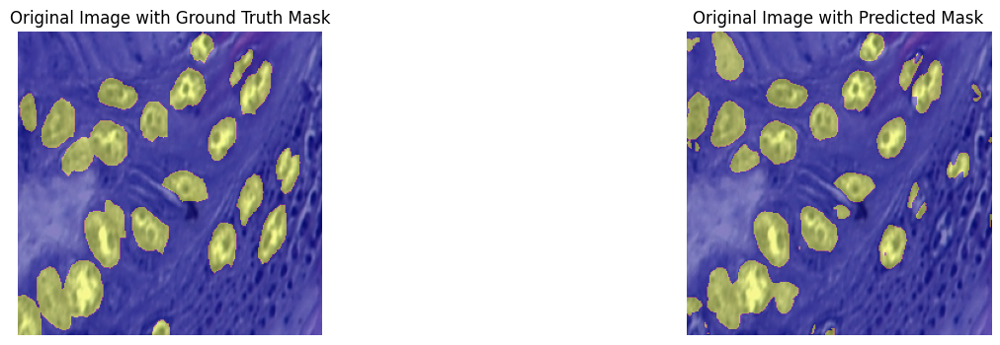

Epoch 87 Loss: 0.2932, Accuracy: 87.33%


Validation Loss: 0.2878, Validation Accuracy: 87.97%


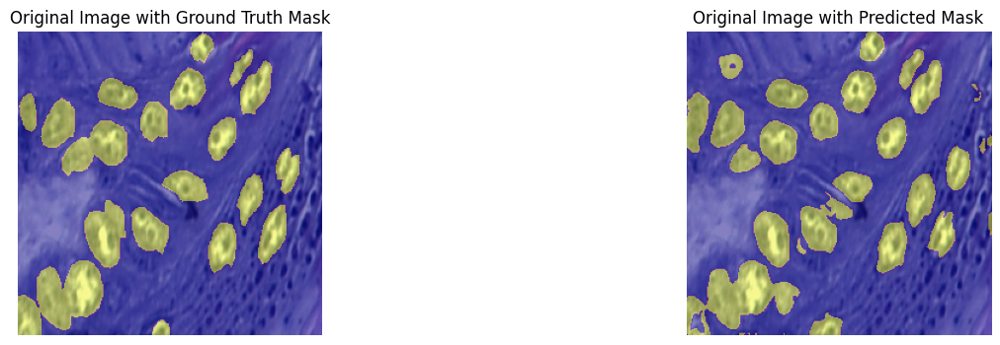

Epoch 88 Loss: 0.2915, Accuracy: 87.34%


Validation Loss: 0.2837, Validation Accuracy: 88.33%


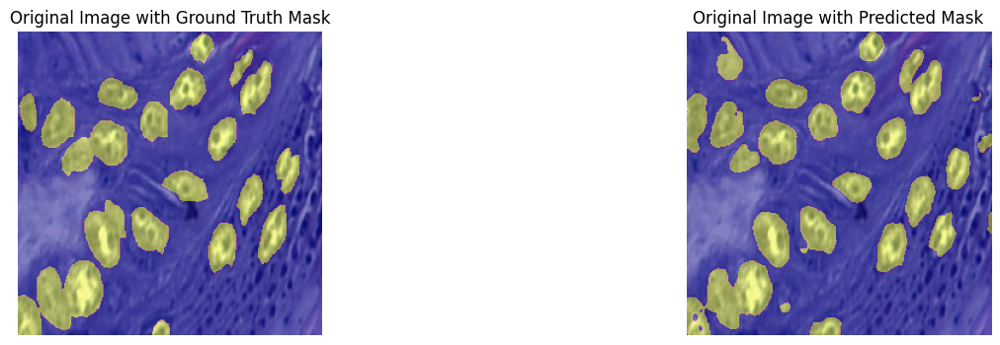

Epoch 89 Loss: 0.2778, Accuracy: 87.98%


Validation Loss: 0.2815, Validation Accuracy: 88.40%


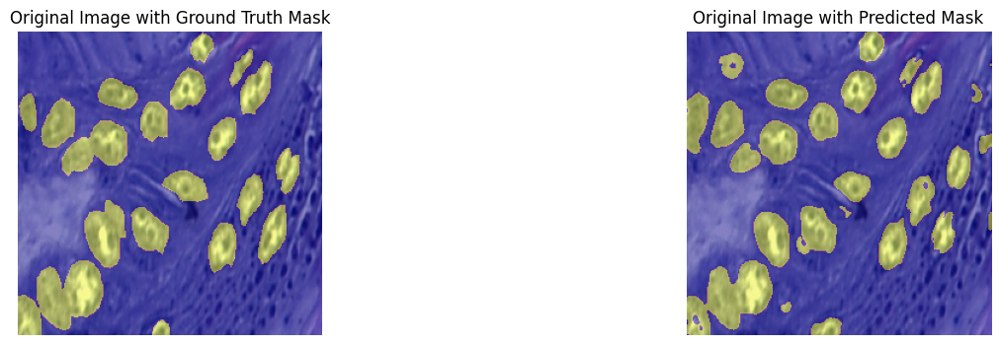

Epoch 90 Loss: 0.2797, Accuracy: 87.84%


Validation Loss: 0.2839, Validation Accuracy: 88.30%


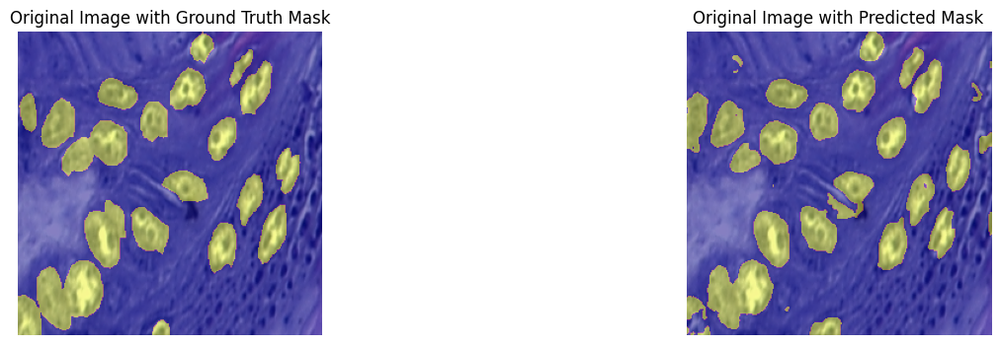

Epoch 91 Loss: 0.2788, Accuracy: 87.87%


Validation Loss: 0.2820, Validation Accuracy: 88.32%


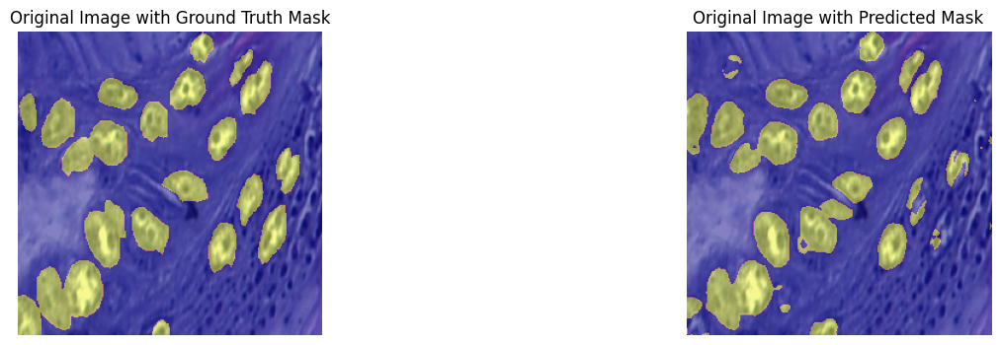

Epoch 92 Loss: 0.2767, Accuracy: 88.03%


Validation Loss: 0.2829, Validation Accuracy: 88.38%


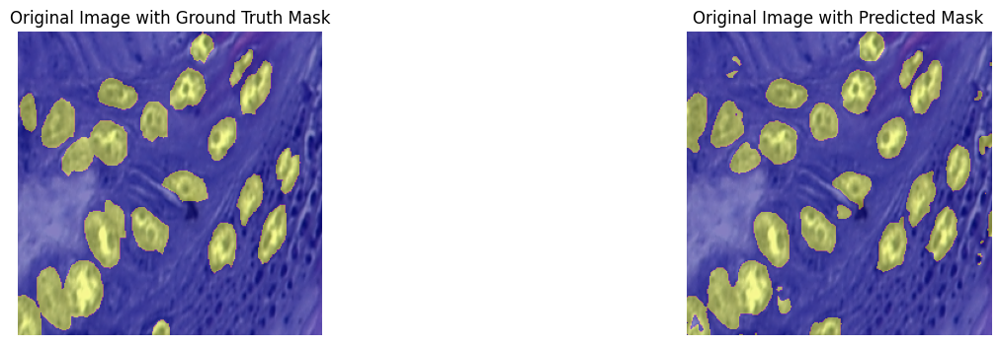

Epoch 93 Loss: 0.2856, Accuracy: 87.62%


Validation Loss: 0.2952, Validation Accuracy: 87.63%


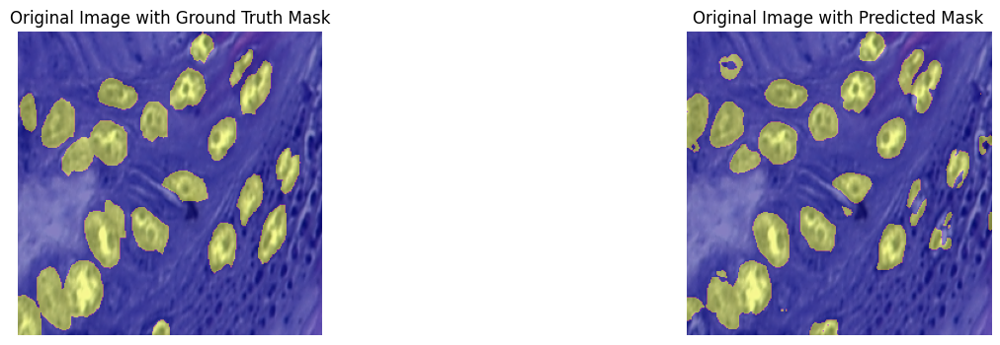

Epoch 94 Loss: 0.2884, Accuracy: 87.47%


Validation Loss: 0.2894, Validation Accuracy: 87.88%


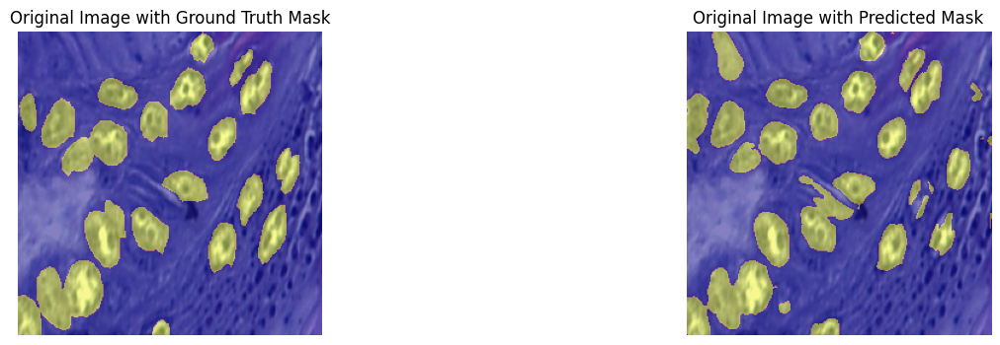

Epoch 95 Loss: 0.2854, Accuracy: 87.69%


Validation Loss: 0.2899, Validation Accuracy: 87.92%


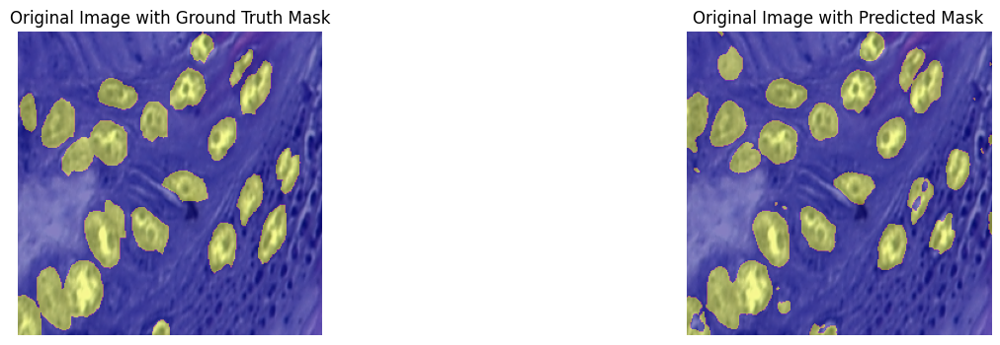

Epoch 96 Loss: 0.2876, Accuracy: 87.56%


Validation Loss: 0.2833, Validation Accuracy: 88.22%


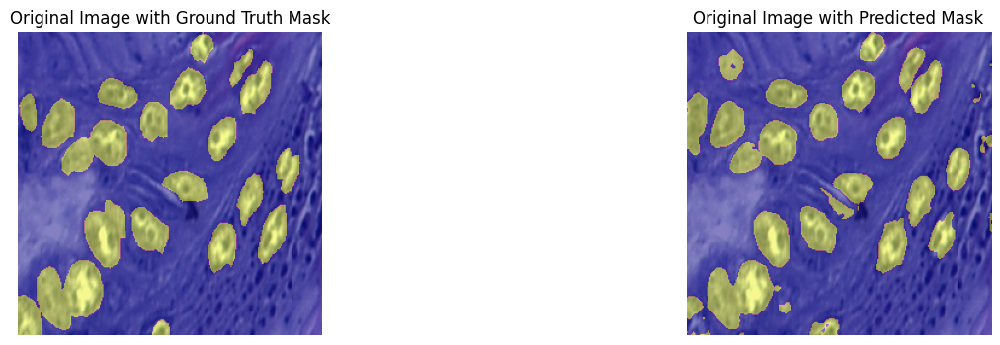

Epoch 97 Loss: 0.2833, Accuracy: 87.64%


Validation Loss: 0.2813, Validation Accuracy: 88.40%


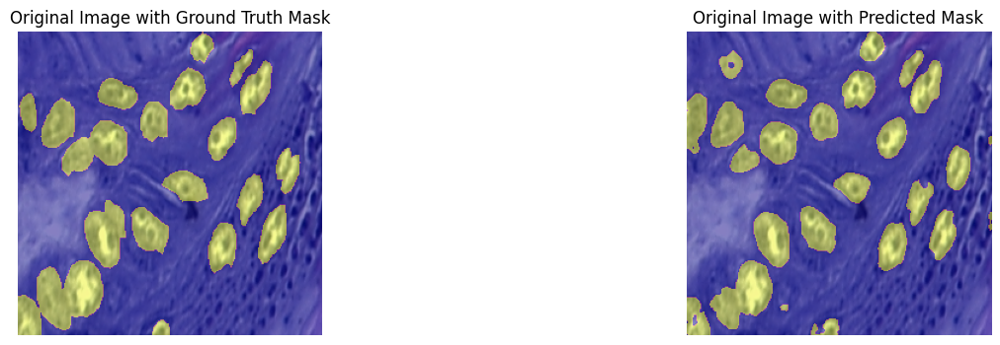

Epoch 98 Loss: 0.2887, Accuracy: 87.63%


Validation Loss: 0.2832, Validation Accuracy: 88.20%


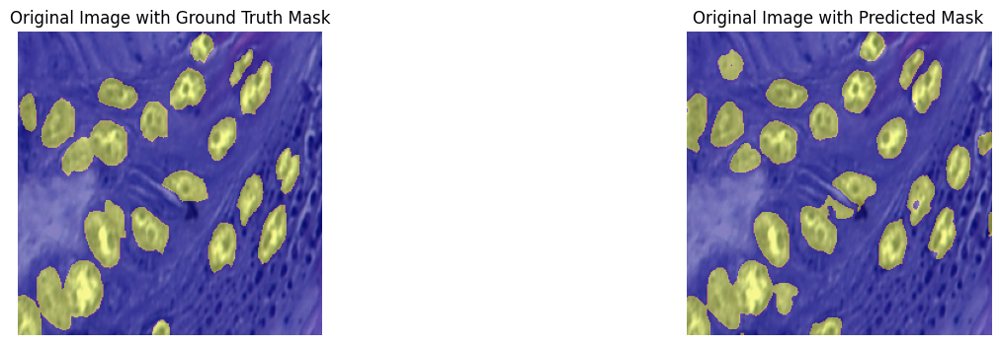

Epoch 99 Loss: 0.2871, Accuracy: 87.60%


Validation Loss: 0.2868, Validation Accuracy: 87.98%


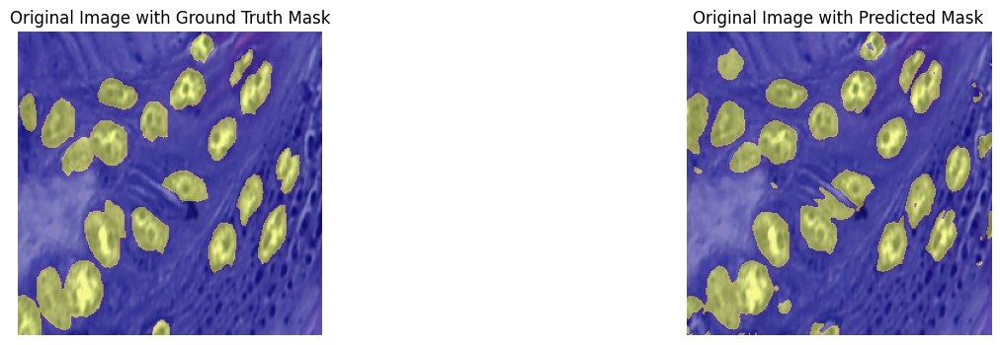

Epoch 100 Loss: 0.2816, Accuracy: 87.83%


Validation Loss: 0.2850, Validation Accuracy: 88.07%


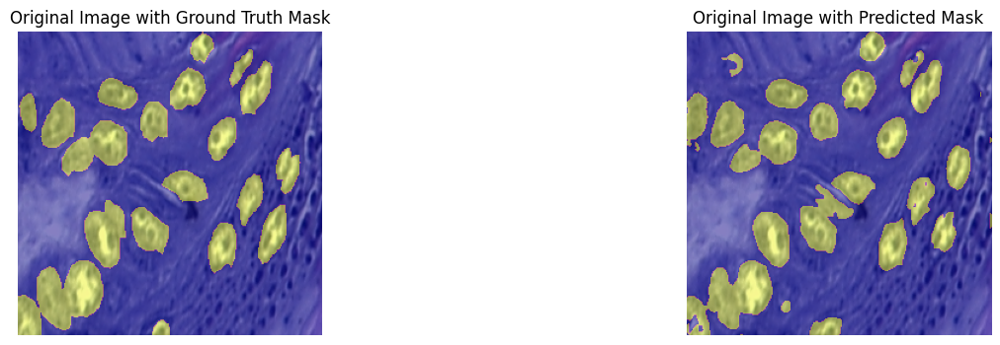

In [5]:

channels = 3
classes = 1
model = UNet(channels, classes)
input_data = torch.randn(1, channels, width, height)
output = model(input_data)
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
model.to(device)

num_epochs = epochs

training_accuracies = []
training_losses = []
val_losses = []
val_accuracies = []


for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct_predictions = 0
    total_samples = 0
    

    for images, masks in tqdm(train_dataloader, desc=f'Epoch {epoch + 1}/{num_epochs}', leave=False):
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        outputs = model(images)

        loss = F.binary_cross_entropy(outputs, masks)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        #thresholding the prediction values
        _, predicted = torch.max(outputs, 1)
        binary_predictions = (outputs > 0.5).float()
        
        #calculating the correct pixels
        correct_predictions += (binary_predictions == masks).sum().item()

        total_samples += masks.numel()

    epoch_loss = running_loss / len(train_dataloader)
    epoch_accuracy = correct_predictions / total_samples

    training_accuracies.append(epoch_accuracy)
    training_losses.append(epoch_loss)

    print(f"Epoch {epoch + 1} Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy * 100:.2f}%")

    #validation
    val_loss = 0.0
    val_correct_predictions = 0
    val_total_samples = 0   
    with torch.no_grad():
        for val_images, val_masks in tqdm(test_dataloader, desc='Validation', leave=False):
            val_images, val_masks = val_images.to(device), val_masks.to(device)
            val_outputs = model(val_images)

            val_loss += F.binary_cross_entropy(val_outputs, val_masks).item()

            val_binary_predictions = (val_outputs > 0.5).float()

            val_correct_predictions += (val_binary_predictions == val_masks).sum().item()

            val_total_samples += val_masks.numel()

    val_epoch_loss = val_loss / len(test_dataloader)
    val_epoch_accuracy = val_correct_predictions / val_total_samples

    val_losses.append(val_epoch_loss)
    val_accuracies.append(val_epoch_accuracy)

    print(f"Validation Loss: {val_epoch_loss:.4f}, Validation Accuracy: {val_epoch_accuracy * 100:.2f}%")
            

    if(show_images):
        with torch.no_grad():
            for images, masks in test_dataloader:
                images, masks = images.to(device), masks.to(device)

                if torch.any(masks > 0):
                    outputs = model(images)
                    probs = outputs

                    images_np = images.cpu().numpy()
                    masks_np = masks.cpu().numpy()
                    probs_np = probs.cpu().numpy()

                    threshold = 0.5
                    preds_np = (probs_np > threshold).astype(np.uint8)
                    preds_np_squeezed = np.squeeze(preds_np, axis=1) 

                    plt.figure(figsize=(16, 4))

                    plt.subplot(1, 2, 1)
                    plt.imshow(images_np[0].transpose((1, 2, 0)))
                    plt.imshow(masks_np[0, 0], alpha=0.5, cmap='plasma')
                    plt.title("Original Image with Ground Truth Mask")
                    plt.axis('off')

                    plt.subplot(1, 2, 2)
                    plt.imshow(images_np[0].transpose((1, 2, 0)))
                    plt.imshow(preds_np_squeezed[0], alpha=0.5, cmap='plasma')
                    plt.title("Original Image with Predicted Mask")
                    plt.axis('off')

                    plt.show()

                    break




### Evaluation

- **Accuracy**: The number of correct predictions out of the total of predictions. Higher means better.

- **Loss**: How well the predictions matched the expected result. Lower means better.

- **Dice**: Calculates the similarity between the intersection of two images. Higher means better.

- **Intersection over Union (IoU)**: It calculates the overlap between the predicted image and the ground truth, but it also takes in consideration the union of the boxes, while Dice only accounts for the intersection.Higher means better.

- **Panoptic Quality (PQ)**: Indicates the performance in segmenting instances accurately. Higher means better.

- **Aggregated Jaccard Index (AJI)**: Indicate the performance of the alignment between predicted and ground truth instance boundaries. Higher means better.

- **Specificity**: Measures the proportion of actual negatives that are correctly identified. Higher means better.

- **Sensitivity**: Measures the proportion of actual positives that are correctly identified. Higher means better.

In [6]:

def calculate_metrics(predictions, targets):
    true_positives = ((predictions == 1) & (targets == 1)).sum().item()
    true_negatives = ((predictions == 0) & (targets == 0)).sum().item()
    false_positives = ((predictions == 1) & (targets == 0)).sum().item()
    false_negatives = ((predictions == 0) & (targets == 1)).sum().item()
    
    intersection = torch.logical_and(predictions, targets).sum().item()
    union = torch.logical_or(predictions, targets).sum().item()
    
    return true_positives, true_negatives, false_positives, false_negatives, intersection, union

model.eval()
accuracies = []
losses = []
dices = [] 
ious = []
specificities = []
sensitivities = []
pqs = []
ajis = []

ev_running_loss = 0.0
ev_correct_predictions = 0
ev_total_samples = 0
ev_true_positives = 0
ev_true_negatives = 0
ev_false_positives = 0
ev_false_negatives = 0
ev_aji = 0
batch_iou = 0

with torch.no_grad():
    for ev_images, ev_masks in test_dataloader:
        ev_images, ev_masks = ev_images.to(device), ev_masks.to(device)
        ev_outputs = model(ev_images)
        ev_loss = F.binary_cross_entropy(ev_outputs, ev_masks)
        ev_running_loss += ev_loss.item()
        losses.append(ev_loss.item())

        #Thresholding the prediction values
        ev_binary_predictions = (ev_outputs > 0.5).float()

        #Calculating the correct pixels
        ev_correct_predictions += (ev_binary_predictions == ev_masks).sum().item()
        ev_total_samples += ev_masks.numel()

        #Calculate metrics
        tp, tn, fp, fn, intersection, union = calculate_metrics(ev_binary_predictions, ev_masks)
        
        ev_true_positives += tp
        ev_true_negatives += tn
        ev_false_positives += fp
        ev_false_negatives += fn
        
        #Calculating IoU
        iou = intersection / union if union > 0 else 0.0
        batch_iou += iou
        ious.append(iou)

        #Calculating AJI
        aji_numerator = intersection
        aji_denominator = union + fp + fn
        aji = aji_numerator / aji_denominator if aji_denominator > 0 else 0.0
        ev_aji += aji
        ajis.append(aji)

        #Calculate accuracy
        batch_accuracy = (ev_binary_predictions == ev_masks).sum().item() / ev_masks.numel()
        accuracies.append(batch_accuracy)

        #Calculate Dice coefficient
        dice_coefficient = (2 * tp) / (2 * tp + fp + fn) if (2 * tp + fp + fn) > 0 else 0.0
        dices.append(dice_coefficient)

        #Precision and recall
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0.0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0.0
        pqs.append(precision * recall if precision + recall > 0 else 0.0)
        
        #Specificity and sensitivity
        sensitivities.append(recall)
        specificities.append(tn / (tn + fp) if (tn + fp) > 0 else 0.0)

#Precision and recall
precision = ev_true_positives / (ev_true_positives + ev_false_positives) if (ev_true_positives + ev_false_positives) > 0 else 0.0
recall = ev_true_positives / (ev_true_positives + ev_false_negatives) if (ev_true_positives + ev_false_negatives) > 0 else 0.0

#Specificity and sensitivity
ev_sensitivity = recall
ev_specificity = ev_true_negatives / (ev_true_negatives + ev_false_positives) if (ev_true_negatives + ev_false_positives) > 0 else 0.0

#Evaluation loss and accuracy
ev_loss = ev_running_loss / len(test_dataloader)
ev_accuracy = ev_correct_predictions / ev_total_samples

#Dice coefficient
ev_temp_dice = (2 * ev_true_positives) / (2 * ev_true_positives + ev_false_positives + ev_false_negatives) if (2 * ev_true_positives + ev_false_positives + ev_false_negatives) > 0 else 0.0

#PQ
ev_pq = precision * recall if precision + recall > 0 else 0.0

#IoU
iou = batch_iou / len(test_dataloader)

#AJI
aji = ev_aji / len(test_dataloader)

#Calculate standard deviation
loss_std = np.std(losses)
accuracy_std = np.std(accuracies)
dice_std = np.std(dices)
iou_std = np.std(ious)
specificity_std = np.std(specificities)
sensitivity_std = np.std(sensitivities)
pq_std = np.std(pqs)
aji_std = np.std(ajis)

print(f'Evaluation Loss: {ev_loss * 100:0.2f}% (Std: {loss_std * 100:0.2f}%)')
print(f'Evaluation Accuracy: {ev_accuracy * 100:0.2f}% (Std: {accuracy_std * 100:0.2f}%)')
print(f'Dice Coefficient: {ev_temp_dice * 100:0.2f}% (Std: {dice_std * 100:0.2f}%)')
print(f'IoU: {iou * 100:0.2f}% (Std: {iou_std * 100:0.2f}%)')
print(f'Specificity: {ev_specificity * 100:0.2f}% (Std: {specificity_std * 100:0.2f}%)')
print(f'Sensitivity: {ev_sensitivity * 100:0.2f}% (Std: {sensitivity_std * 100:0.2f}%)')
print(f'PQ: {ev_pq * 100:0.2f}% (Std: {pq_std * 100:0.2f}%)')
print(f'AJI: {aji * 100:0.2f}% (Std: {aji_std * 100:0.2f}%)')


Evaluation Loss: 27.73% (Std: 7.92%)
Evaluation Accuracy: 88.15% (Std: 3.76%)
Dice Coefficient: 78.12% (Std: 7.76%)
IoU: 63.57% (Std: 10.35%)
Specificity: 94.48% (Std: 1.42%)
Sensitivity: 72.71% (Std: 10.83%)
PQ: 61.36% (Std: 11.56%)
AJI: 47.45% (Std: 11.33%)


### Plotting Charts



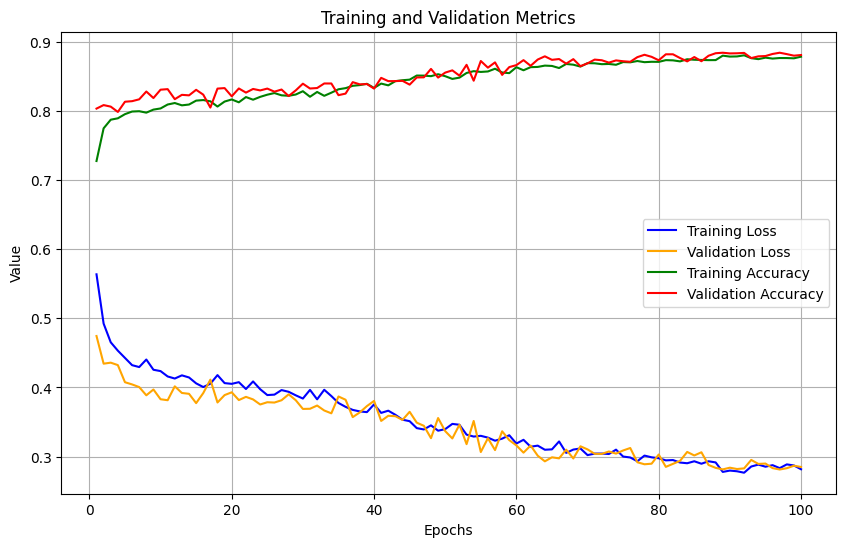

In [7]:
epochs_list = range(1, num_epochs + 1)

plt.figure(figsize=(10, 6))

plt.plot(epochs_list, training_losses, label='Training Loss', color='blue')
plt.plot(epochs_list, val_losses, label='Validation Loss', color='orange')
plt.plot(epochs_list, training_accuracies, label='Training Accuracy', color='green')
plt.plot(epochs_list, val_accuracies, label='Validation Accuracy', color='red')

plt.xlabel('Epochs')
plt.ylabel('Value')
plt.title('Training and Validation Metrics')
plt.legend()
plt.grid(True)
plt.show()


### Predictions

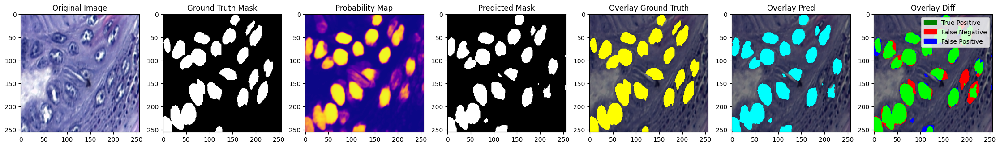

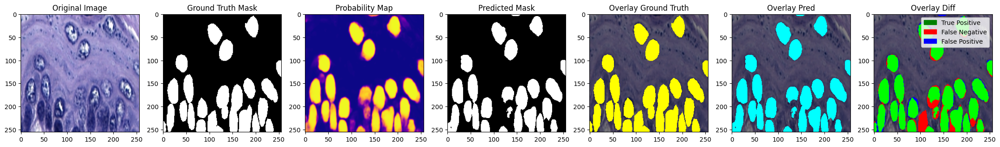

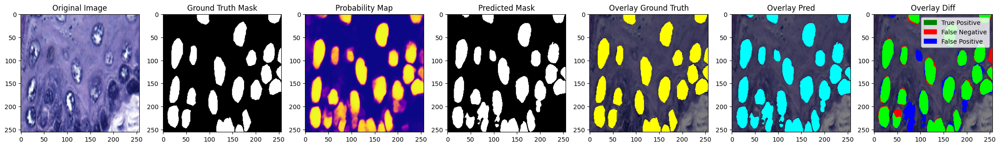

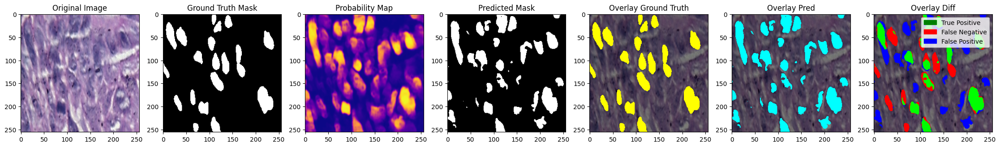

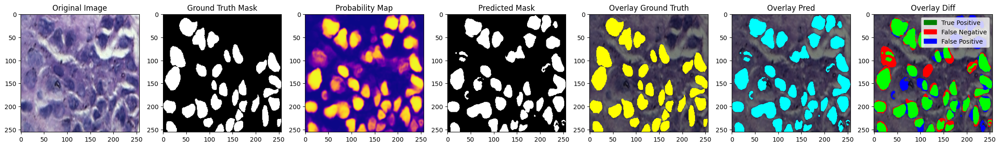

In [8]:
import torch.nn.functional as F
import matplotlib.patches as mpatches
if show_images:
    with torch.no_grad():
        counter = 0
        brightness = 0.5
        for images, masks in test_dataloader:
            images, masks = images.to(device), masks.to(device)
            images_normalized = images

            outputs = model(images_normalized)
            probs = outputs
            #probs = F.softmax(outputs, dim=1)

            images_np = images_normalized.cpu().numpy()
            masks_np = masks.cpu().numpy()
            probs_np = probs.cpu().numpy()

            threshold = 0.5
            preds_np = (probs_np > threshold).astype(np.uint8)
            preds_np_squeezed = np.squeeze(preds_np, axis=1) 

            original_image = images_np[0].transpose((1, 2, 0))
            ground_truth_mask = masks_np[0, 0]
            predicted_mask = preds_np_squeezed[0]
            probability_map = probs_np[0, 0]

            overlay_gt = original_image.copy()
            overlay_gt = original_image * brightness # to make it a little darker
            overlay_gt[ground_truth_mask == 1] = [1, 1, 0]

            overlay_pred = original_image.copy()
            overlay_pred = original_image * brightness
            overlay_pred[predicted_mask == 1] = [0, 1, 1]

            overlay_diff = original_image.copy()
            overlay_diff = original_image * brightness 
            overlay_diff[(ground_truth_mask == 1) & (predicted_mask == 1)] = [0, 1, 0]  #correct predictions
            overlay_diff[(ground_truth_mask == 1) & (predicted_mask == 0)] = [1, 0, 0]  #missed predictions
            overlay_diff[(ground_truth_mask == 0) & (predicted_mask == 1)] = [0, 0, 1]  #false positives

            plt.figure(figsize=(28, 4))

            plt.subplot(1, 7, 1)
            plt.imshow(original_image)
            plt.title("Original Image")

            plt.subplot(1, 7, 2)
            plt.imshow(ground_truth_mask, cmap='gray')
            plt.title("Ground Truth Mask")

            plt.subplot(1, 7, 3)
            plt.imshow(probability_map, cmap='plasma')
            plt.title("Probability Map")

            plt.subplot(1, 7, 4)
            plt.imshow(predicted_mask, cmap='gray')
            plt.title("Predicted Mask")

            plt.subplot(1, 7, 5)
            plt.imshow(overlay_gt)
            plt.title("Overlay Ground Truth")

            plt.subplot(1, 7, 6)
            plt.imshow(overlay_pred)
            plt.title("Overlay Pred")

            green_patch = mpatches.Patch(color='green', label='True Positive')
            red_patch = mpatches.Patch(color='red', label='False Negative')
            blue_patch = mpatches.Patch(color='blue', label='False Positive')
            plt.subplot(1, 7, 7)
            plt.imshow(overlay_diff)
            plt.title("Overlay Diff")
            plt.legend(handles=[green_patch, red_patch, blue_patch], loc='upper right')

            plt.show()

            counter += 1
            if counter == 10:
                break